# Plots

In [577]:
import os
import pandas as pd
from tqdm import tqdm

parent_folder = "trained_models_mistral/"

all_data = pd.DataFrame()

for folder_name in tqdm(os.listdir(parent_folder), desc="Processing folders"):
    folder_path = os.path.join(parent_folder, folder_name)
    
    if os.path.isdir(folder_path):
        for log_file_path in [os.path.join(folder_path, "test_metrics.log"), os.path.join(folder_path, "training_metrics.log")]:
            if os.path.exists(log_file_path):
                
                df = pd.read_csv(log_file_path)
                
                last_row = df.iloc[-1:].copy()
                
                last_row['Folder'] = folder_name
                last_row['Layer'] = folder_name.split('_')[1]
                last_row['Neurons'] = int(folder_name.split('_')[2])

                if 'ajmc' in folder_name:
                    last_row['Dataset'] = 'ajmc'
                    # continue
                    # print(folder_name, folder_name.split('_')[3], last_row)
                elif 'newseye' in folder_name:
                    last_row['Dataset'] = 'newseye'
                    continue
                else:
                    last_row['Dataset'] = 'hipe2020'

                if last_row['Neurons'].values[0] == 0:
                    
                    avg_values = df.mean().to_dict()
                    std_values = df.std().to_dict()
                    
                    for column in df.columns:
                        last_row[f"{column}_avg"] = avg_values.get(column, None)
                        last_row[f"{column}_std"] = std_values.get(column, None)

                if '.' in folder_name.split('_')[3]:
                    
                    last_row['Dampening Factor'] = float(folder_name.split('_')[3])
                else:
                    last_row['Dampening Factor'] = float(0.1)
                    
                all_data = pd.concat([all_data, last_row], ignore_index=True)

all_data.tail()

# 16850

Processing folders: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 18756/18756 [06:48<00:00, 45.94it/s]


,precision,recall,f1,accuracy,Folder,Layer,Neurons,Dataset,Dampening Factor
37421,0.016758,0.069652,0.027016,0.772816,test_24_8200_0.1_hipe2020,24,8200,hipe2020,0.1
37422,0.496607,0.572139,0.531704,0.955222,test_18_7200_0.9_hipe2020,18,7200,hipe2020,0.9
37423,0.496607,0.572139,0.531704,0.955222,test_18_7200_0.9_hipe2020,18,7200,hipe2020,0.9
37424,0.000000,0.000000,0.000000,0.000000,test_19_8800_0.1_hipe2020,19,8800,hipe2020,0.1
37425,0.000000,0.000000,0.000000,0.000000,test_19_8800_0.1_hipe2020,19,8800,hipe2020,0.1


In [578]:
all_data['Dataset'].unique()


array(['ajmc', 'hipe2020'], dtype=object)

In [579]:
all_data[all_data['Layer'] == '-1']

,precision,recall,f1,accuracy,Folder,Layer,Neurons,Dataset,Dampening Factor
12695,0.476190,0.45045,0.462963,0.935338,test_-1_-1_-1.0_ajmc,-1,-1,ajmc,-1.0
23858,0.491164,0.57285,0.528871,0.954922,test_-1_-1_-1.0_hipe2020,-1,-1,hipe2020,-1.0


In [580]:
all_data['Dampening Factor'].unique()

array([ 0.1,  0.9,  0.5, -1. ])

In [581]:
all_data = all_data[all_data['Dampening Factor'].isin([-1, 0.1, 0.5, 0.9])]


In [582]:
all_data['Dampening Factor'].unique()

array([ 0.1,  0.9,  0.5, -1. ])

In [583]:
all_data['Layer'].unique()

array(['18', '21', '17', '26', '25', '4', '10', '28', '2', '12', '15',
       '16', '22', '14', '27', '3', '30', '31', '8', '9', '24', '20', '5',
       '11', '0', '7', '13', '19', '23', '1', '29', '6', '-1'],
      dtype=object)

In [584]:
all_data[all_data['Layer'] == '-1']

,precision,recall,f1,accuracy,Folder,Layer,Neurons,Dataset,Dampening Factor
12695,0.476190,0.45045,0.462963,0.935338,test_-1_-1_-1.0_ajmc,-1,-1,ajmc,-1.0
23858,0.491164,0.57285,0.528871,0.954922,test_-1_-1_-1.0_hipe2020,-1,-1,hipe2020,-1.0


In [585]:
print('what')

what


In [586]:
all_data.loc[all_data['Layer'] == '-1', 'Dampening Factor'] = 1.0

In [587]:
all_data.loc[all_data['Layer'] == '-1', 'Neurons'] = 0

In [588]:
all_data.loc[all_data['Dampening Factor'] == 1.0]

,precision,recall,f1,accuracy,Folder,Layer,Neurons,Dataset,Dampening Factor
12695,0.476190,0.45045,0.462963,0.935338,test_-1_-1_-1.0_ajmc,-1,0,ajmc,1.0
23858,0.491164,0.57285,0.528871,0.954922,test_-1_-1_-1.0_hipe2020,-1,0,hipe2020,1.0


In [589]:
all_data['Layer'].unique()

array(['18', '21', '17', '26', '25', '4', '10', '28', '2', '12', '15',
       '16', '22', '14', '27', '3', '30', '31', '8', '9', '24', '20', '5',
       '11', '0', '7', '13', '19', '23', '1', '29', '6', '-1'],
      dtype=object)

In [590]:
all_data[all_data['Layer'] == '-1']

,precision,recall,f1,accuracy,Folder,Layer,Neurons,Dataset,Dampening Factor
12695,0.476190,0.45045,0.462963,0.935338,test_-1_-1_-1.0_ajmc,-1,0,ajmc,1.0
23858,0.491164,0.57285,0.528871,0.954922,test_-1_-1_-1.0_hipe2020,-1,0,hipe2020,1.0


In [591]:
all_data.loc[all_data['Neurons'] == -1, 'Neurons'] = 0.0

In [592]:
all_data['Dampening Factor'].unique()

array([0.1, 0.9, 0.5, 1. ])

In [593]:
all_data['Neurons'].unique()

array([ 5000,  9600,  7400,  2700,   100,  1800,  1200,  6400,   200,
        7700,  5700,  2500,  5400,   600,  1400,  4500,  1300,  5300,
        4900,  3000,  2900,  1000,  6300,  2100,  2400,   300,  4300,
        8300,  3600,   900,  6200,  7500,  9300,  6800,  8000,  5800,
        1500,  8100,  7100, 10000,  4400,  6900,  2200,  7600,  3100,
        3500,  9100,  7000,  8800,  2000,  5100,  3200,  6100,  2600,
        5200,  8700,  4700,  4000,  4600,  5500,  7200,  2800,  9700,
         500,  3400,   800,  8400,  5900,   400,  1700,  1100,  7300,
        3900,  3700,  9000,  9200,   700,  4100,  2300,  4800,  8200,
        3800,  6500,  9500,  8600,  6700,  6000,  8900,  1600,  9800,
        1900,  9900,  5600,  7900,  9400,  7800,  6600,  4200,  3300,
        8500,     0])

In [594]:
len(all_data)

37426

In [595]:
all_data[all_data['Dampening Factor'] == 1.0]

,precision,recall,f1,accuracy,Folder,Layer,Neurons,Dataset,Dampening Factor
12695,0.476190,0.45045,0.462963,0.935338,test_-1_-1_-1.0_ajmc,-1,0,ajmc,1.0
23858,0.491164,0.57285,0.528871,0.954922,test_-1_-1_-1.0_hipe2020,-1,0,hipe2020,1.0


In [596]:
all_data['f1'] = pd.to_numeric(all_data['f1'], errors='coerce')


In [597]:
# Scale the F1 scores by multiplying by 100
all_data['f1'] = all_data['f1'] * 100.0

In [598]:
max(all_data['f1'])

55.27297388945405

In [599]:
len(all_data)

37426

In [600]:
all_data['Layer'].unique()

array(['18', '21', '17', '26', '25', '4', '10', '28', '2', '12', '15',
       '16', '22', '14', '27', '3', '30', '31', '8', '9', '24', '20', '5',
       '11', '0', '7', '13', '19', '23', '1', '29', '6', '-1'],
      dtype=object)

In [602]:
all_data.head()

,precision,recall,f1,accuracy,Folder,Layer,Neurons,Dataset,Dampening Factor
0,0.242588,0.270270,25.568182,0.890033,test_18_5000_0.1_ajmc,18,5000,ajmc,0.1
1,0.242588,0.270270,25.568182,0.890033,test_18_5000_0.1_ajmc,18,5000,ajmc,0.1
2,0.494232,0.578536,53.307138,0.954892,test_21_9600_0.9_hipe2020,21,9600,hipe2020,0.9
3,0.494232,0.578536,53.307138,0.954892,test_21_9600_0.9_hipe2020,21,9600,hipe2020,0.9
4,0.465409,0.444444,45.468510,0.934720,test_17_7400_0.9_ajmc,17,7400,ajmc,0.9


In [603]:
max(all_data['f1'])

55.27297388945405

In [604]:
all_data[all_data['f1'] > 90.0]

,precision,recall,f1,accuracy,Folder,Layer,Neurons,Dataset,Dampening Factor


In [605]:
all_data.loc[all_data['Dampening Factor'] == 1.0]

,precision,recall,f1,accuracy,Folder,Layer,Neurons,Dataset,Dampening Factor
12695,0.476190,0.45045,46.296296,0.935338,test_-1_-1_-1.0_ajmc,-1,0,ajmc,1.0
23858,0.491164,0.57285,52.887139,0.954922,test_-1_-1_-1.0_hipe2020,-1,0,hipe2020,1.0


In [606]:
max(all_data['f1'][all_data['Neurons'] == 0])

52.887139107611546

In [607]:
max(all_data['f1'][all_data['Neurons'] > 0])

55.27297388945405

In [608]:
all_data.columns

Index(['precision', 'recall', 'f1', 'accuracy', 'Folder', 'Layer', 'Neurons',
       'Dataset', 'Dampening Factor'],
      dtype='object')

0.0 54.688980107357125


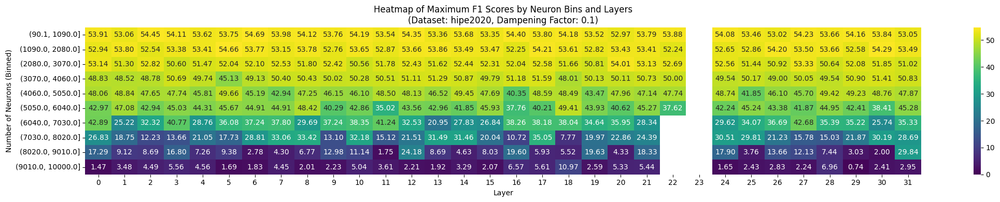

0.80096115338406 55.27297388945405


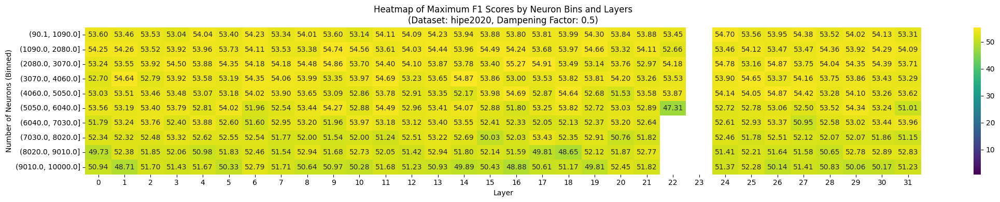

51.58311345646439 54.56980247740207


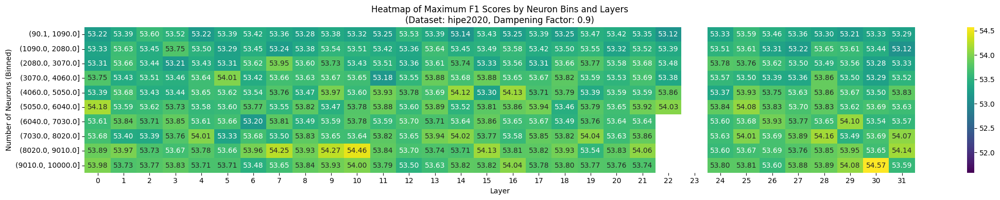

0.0 48.7218045112782


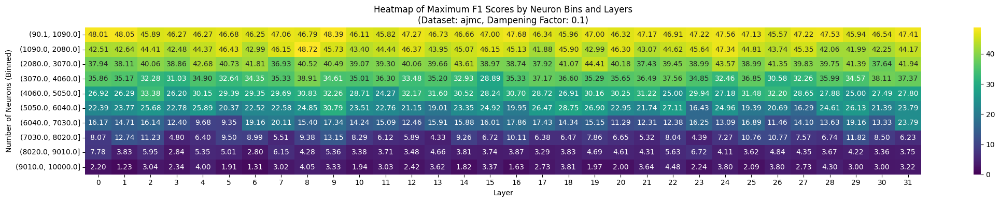

2.49759846301633 50.858034321372855


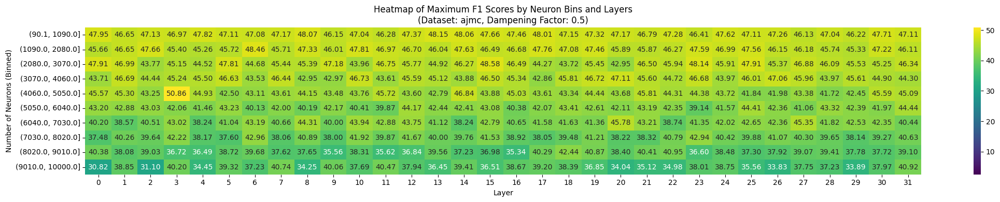

43.18529862174579 48.68217054263566


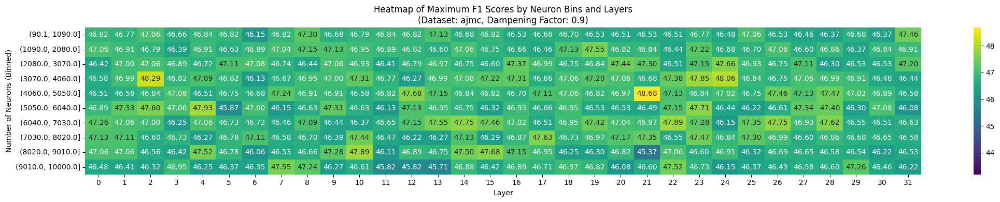

In [610]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

all_data['Layer'] = all_data['Layer'].astype(int)

num_bins = 10

neuron_data = all_data[(all_data['Neurons'] != 0) & (all_data['Layer'] != -1)]

neuron_data['Neurons_Binned'] = pd.cut(neuron_data['Neurons'], bins=num_bins)

datasets = ['hipe2020', 'ajmc']
dampening_factors = neuron_data['Dampening Factor'].unique()
all_layers = list(range(32))  # Layers from 0 to 31

for dataset in datasets:
    for dampening_factor in [0.1, 0.5, 0.9]:
        dataset_data = neuron_data[(neuron_data['Dataset'] == dataset) & 
                                   (neuron_data['Dampening Factor'] == dampening_factor)]
        local_min = dataset_data['f1'].min()
        local_max = dataset_data['f1'].max()

        print(local_min, local_max)

        pivot_data = dataset_data.pivot_table(values='f1', index='Neurons_Binned', columns='Layer', aggfunc='max')

        pivot_data = pivot_data.reindex(columns=all_layers)

        plt.figure(figsize=(22, 4))
        ax = sns.heatmap(pivot_data, annot=True, fmt=".2f", cmap='viridis', xticklabels=pivot_data.columns,
                        vmin=local_min, vmax=local_max)
        
        plt.title(f'Heatmap of Maximum F1 Scores by Neuron Bins and Layers\n(Dataset: {dataset}, Dampening Factor: {dampening_factor})')
        plt.ylabel('Number of Neurons (Binned)')
        plt.xlabel('Layer')
        plt.tight_layout()
        plt.show()


52.887139107611546
Local min for hipe2020: -100.0
Local max for hipe2020: 4.511181398918086


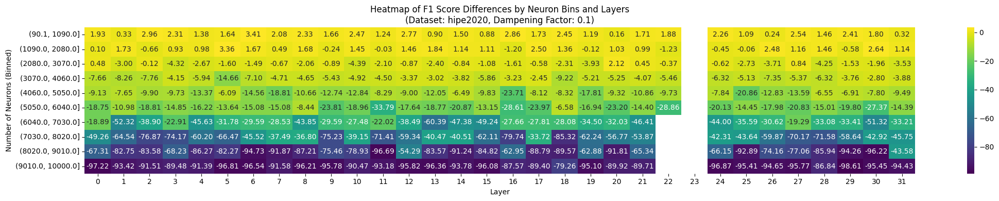

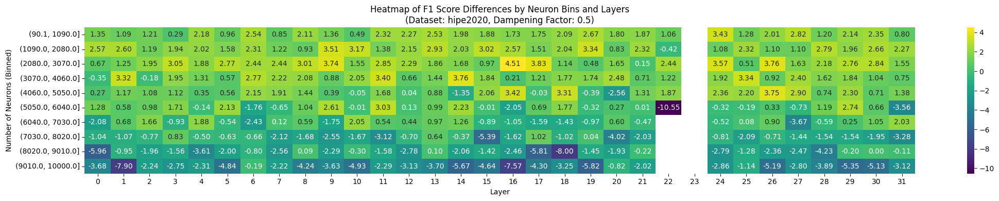

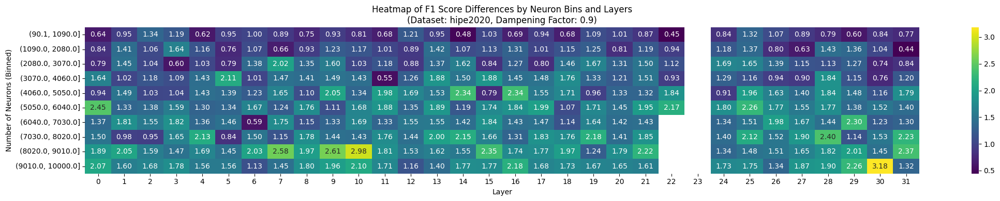

46.296296296296305
Local min for ajmc: -100.0
Local max for ajmc: 9.853354134165347


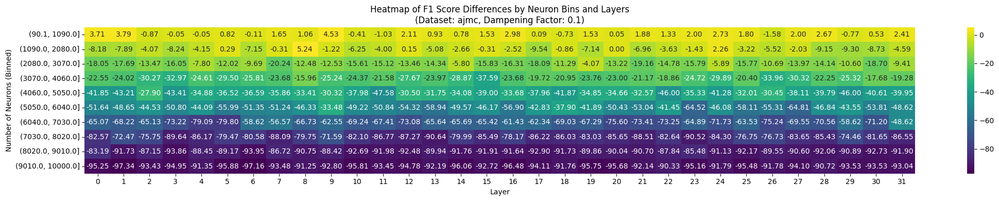

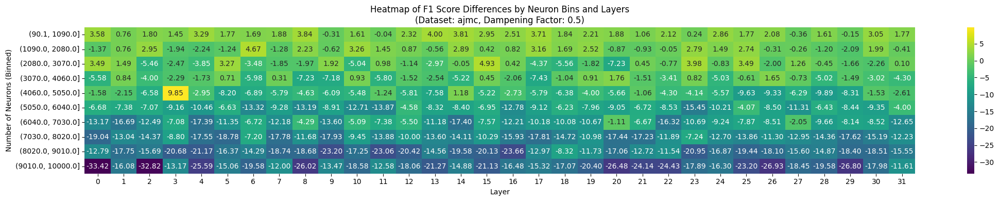

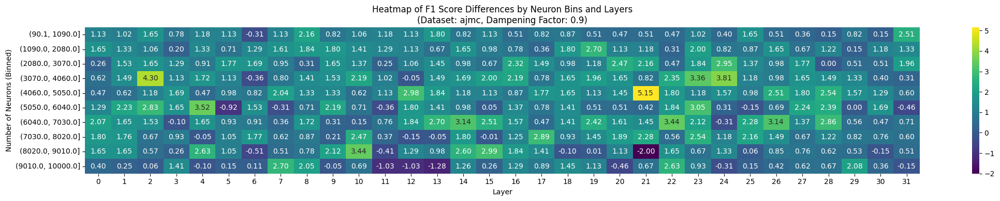

In [611]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import warnings

warnings.filterwarnings("ignore")

all_data['Layer'] = all_data['Layer'].astype(int)

num_bins = 10

neuron_data = all_data[(all_data['Neurons'] != 0) & (all_data['Layer'] != -1)]

neuron_data['Neurons_Binned'] = pd.cut(neuron_data['Neurons'], bins=num_bins)

datasets = ['hipe2020', 'ajmc']
dampening_factors = neuron_data['Dampening Factor'].unique()
all_layers = list(range(32))

for dataset in datasets:
    max_f1 = all_data[all_data['Dataset'] == dataset]
    max_f1 = max_f1[max_f1['Layer'] == -1].iloc[0]['f1']
    print(max_f1)
    
    local_min = float('inf')
    local_max = float('-inf')
    
    for dampening_factor in [0.1, 0.5, 0.9]:
        dataset_data = neuron_data[(neuron_data['Dataset'] == dataset) & 
                                   (neuron_data['Dampening Factor'] == dampening_factor)]
        dataset_data['Improvement_Score'] = (dataset_data['f1'] - max_f1) / max_f1 * 100
        
        current_min = dataset_data['Improvement_Score'].min()
        current_max = dataset_data['Improvement_Score'].max()
        if current_min < local_min:
            local_min = current_min
        if current_max > local_max:
            local_max = current_max
    
    print(f"Local min for {dataset}:", local_min)
    print(f"Local max for {dataset}:", local_max)

    for dampening_factor in [0.1, 0.5, 0.9]:
        dataset_data = neuron_data[(neuron_data['Dataset'] == dataset) & 
                                   (neuron_data['Dampening Factor'] == dampening_factor)]
        dataset_data['Improvement_Score'] = (dataset_data['f1'] - max_f1) / max_f1 * 100

        pivot_data = dataset_data.pivot_table(values='Improvement_Score', index='Neurons_Binned', columns='Layer', aggfunc='max')

        pivot_data = pivot_data.reindex(columns=all_layers)

        plt.figure(figsize=(22, 4))
        ax = sns.heatmap(pivot_data, annot=True, fmt=".2f", cmap='viridis', xticklabels=pivot_data.columns)#,
                         # vmin=local_min, vmax=local_max)

        plt.title(f'Heatmap of F1 Score Differences by Neuron Bins and Layers\n(Dataset: {dataset}, Dampening Factor: {dampening_factor})')
        plt.ylabel('Number of Neurons (Binned)')
        plt.xlabel('Layer')
        plt.tight_layout()
        plt.show()


46.296296296296305
Local min for ajmc: -100.0
Local max for ajmc: 9.853354134165347


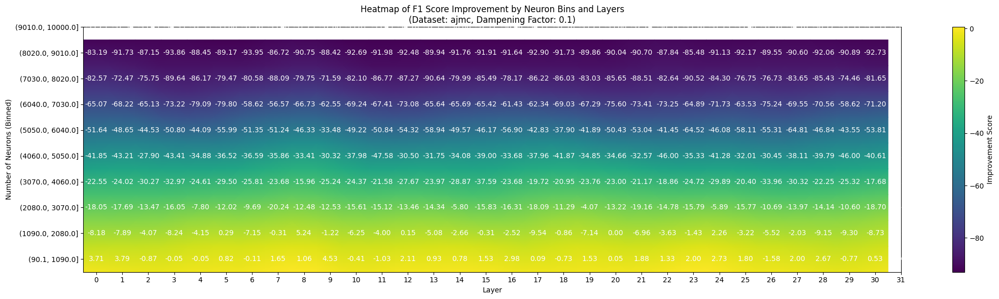

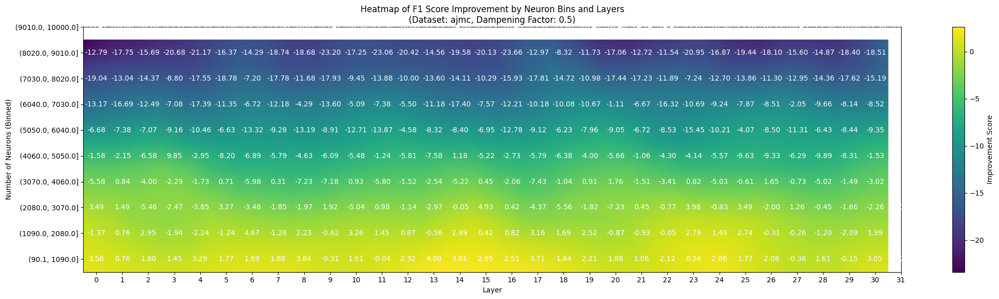

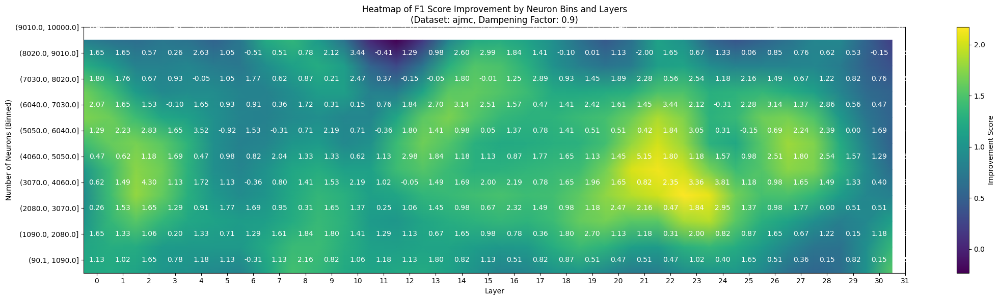

In [612]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import warnings
import numpy as np
from scipy.ndimage import gaussian_filter

warnings.filterwarnings("ignore")

all_data['Layer'] = all_data['Layer'].astype(int)

num_bins = 10

neuron_data = all_data[(all_data['Neurons'] != 0) & (all_data['Layer'] != -1)]

neuron_data['Neurons_Binned'] = pd.cut(neuron_data['Neurons'], bins=num_bins)

datasets = ['hipe2020', 'ajmc']
datasets = ['ajmc']
dampening_factors = neuron_data['Dampening Factor'].unique()
all_layers = list(range(32))

for dataset in datasets:
    max_f1 = all_data[all_data['Dataset'] == dataset]
    max_f1 = max_f1[max_f1['Layer'] == -1].iloc[0]['f1']
    print(max_f1)
    
    local_min = float('inf')
    local_max = float('-inf')
    
    for dampening_factor in [0.1, 0.5, 0.9]:
        dataset_data = neuron_data[(neuron_data['Dataset'] == dataset) & 
                                   (neuron_data['Dampening Factor'] == dampening_factor)]
        dataset_data['Improvement_Score'] = (dataset_data['f1'] - max_f1) / max_f1 * 100
        
        current_min = dataset_data['Improvement_Score'].min()
        current_max = dataset_data['Improvement_Score'].max()
        if current_min < local_min:
            local_min = current_min
        if current_max > local_max:
            local_max = current_max
    
    print(f"Local min for {dataset}:", local_min)
    print(f"Local max for {dataset}:", local_max)

    for dampening_factor in [0.1, 0.5, 0.9]:
        dataset_data = neuron_data[(neuron_data['Dataset'] == dataset) & 
                                   (neuron_data['Dampening Factor'] == dampening_factor)]
        dataset_data['Improvement_Score'] = (dataset_data['f1'] - max_f1) / max_f1 * 100

        pivot_data = dataset_data.pivot_table(values='Improvement_Score', index='Neurons_Binned', columns='Layer', aggfunc='max')

        pivot_data = pivot_data.reindex(columns=all_layers)

        pivot_data_filled = pivot_data.fillna(0)

        smoothed_data = gaussian_filter(pivot_data_filled, sigma=1.0)

        plt.figure(figsize=(22, 6))
        
        X, Y = np.meshgrid(range(len(all_layers)), range(num_bins))
        Z = smoothed_data
        
        plt.pcolormesh(X, Y, Z, shading='gouraud', cmap='viridis')
        
        for y in range(pivot_data.shape[0]):
            for x in range(pivot_data.shape[1]):
                if not np.isnan(pivot_data.iloc[y, x]):
                    plt.text(x + 0.5, y + 0.5, f'{pivot_data.iloc[y, x]:.2f}', ha='center', va='center', color='white')

        plt.xticks(np.arange(0.5, len(all_layers) + 0.5), all_layers)
        plt.yticks(np.arange(0.5, num_bins + 0.5), [str(i) for i in pivot_data.index])

        plt.title(f'Heatmap of F1 Score Improvement by Neuron Bins and Layers\n(Dataset: {dataset}, Dampening Factor: {dampening_factor})')
        plt.ylabel('Number of Neurons (Binned)')
        plt.xlabel('Layer')
        plt.colorbar(label='Improvement Score')
        plt.tight_layout()  # Adjust the layout to fit everything nicely
        plt.show()


In [613]:
neuron_data

,precision,recall,f1,accuracy,Folder,Layer,Neurons,Dataset,Dampening Factor,Neurons_Binned
0,0.242588,0.270270,25.568182,0.890033,test_18_5000_0.1_ajmc,18,5000,ajmc,0.1,"(4060.0, 5050.0]"
1,0.242588,0.270270,25.568182,0.890033,test_18_5000_0.1_ajmc,18,5000,ajmc,0.1,"(4060.0, 5050.0]"
2,0.494232,0.578536,53.307138,0.954892,test_21_9600_0.9_hipe2020,21,9600,hipe2020,0.9,"(9010.0, 10000.0]"
3,0.494232,0.578536,53.307138,0.954892,test_21_9600_0.9_hipe2020,21,9600,hipe2020,0.9,"(9010.0, 10000.0]"
4,0.465409,0.444444,45.468510,0.934720,test_17_7400_0.9_ajmc,17,7400,ajmc,0.9,"(7030.0, 8020.0]"
...,...,...,...,...,...,...,...,...,...,...
37421,0.016758,0.069652,2.701585,0.772816,test_24_8200_0.1_hipe2020,24,8200,hipe2020,0.1,"(8020.0, 9010.0]"
37422,0.496607,0.572139,53.170410,0.955222,test_18_7200_0.9_hipe2020,18,7200,hipe2020,0.9,"(7030.0, 8020.0]"
37423,0.496607,0.572139,53.170410,0.955222,test_18_7200_0.9_hipe2020,18,7200,hipe2020,0.9,"(7030.0, 8020.0]"
37424,0.000000,0.000000,0.000000,0.000000,test_19_8800_0.1_hipe2020,19,8800,hipe2020,0.1,"(8020.0, 9010.0]"


46.296296296296305
Local min for ajmc: 0.0
Local max for ajmc: 9.853354134165347


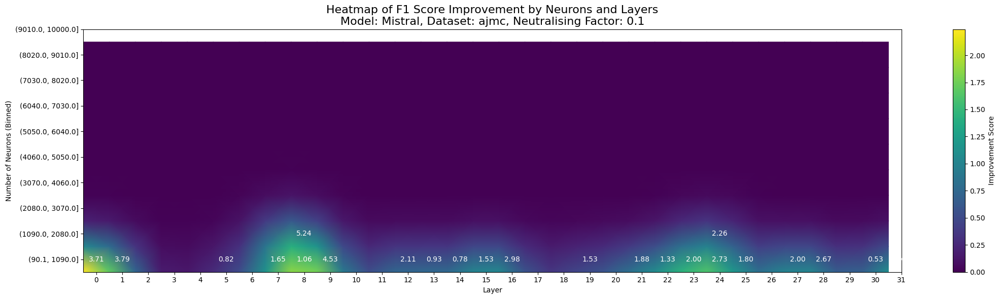

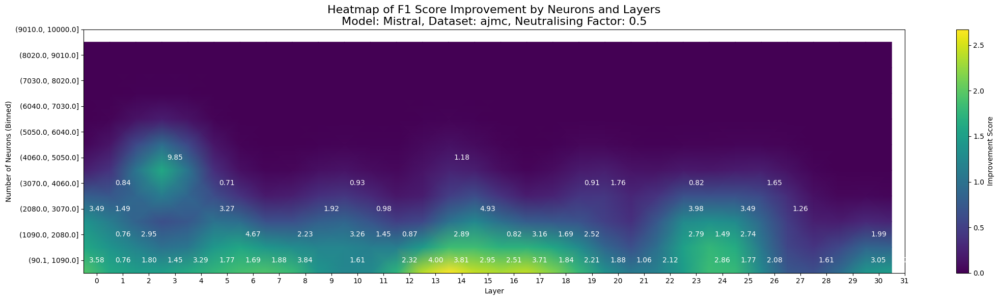

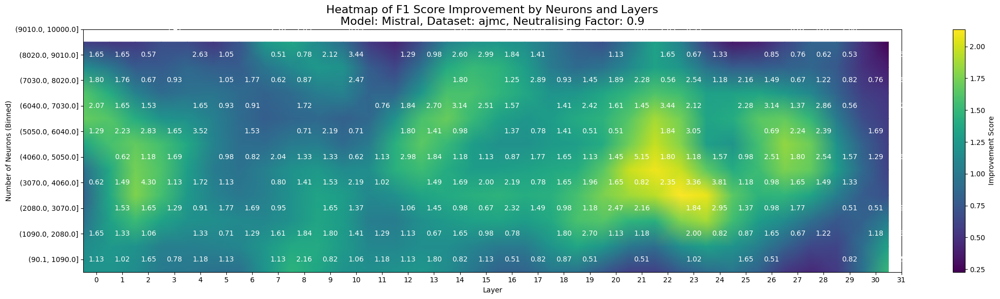

In [614]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import warnings
import numpy as np
from scipy.ndimage import gaussian_filter

MODEL = 'Mistral' # Mistral, LLama 2

warnings.filterwarnings("ignore")

all_data['Layer'] = all_data['Layer'].astype(int)

num_bins = 10

neuron_data = all_data[(all_data['Neurons'] != 0) & (all_data['Layer'] != -1)]

neuron_data['Neurons_Binned'] = pd.cut(neuron_data['Neurons'], bins=num_bins)

datasets = ['ajmc']
dampening_factors = neuron_data['Dampening Factor'].unique()
all_layers = list(range(32))

for dataset in datasets:
    max_f1 = all_data[all_data['Dataset'] == dataset]
    max_f1 = max_f1[max_f1['Layer'] == -1].iloc[0]['f1']
    print(max_f1)
    
    local_min = float('inf')
    local_max = float('-inf')
    
    for dampening_factor in [0.1, 0.5, 0.9]:
        dataset_data = neuron_data[(neuron_data['Dataset'] == dataset) & 
                                   (neuron_data['Dampening Factor'] == dampening_factor)]
        dataset_data['Improvement_Score'] = (dataset_data['f1'] - max_f1) / max_f1 * 100
        dataset_data.loc[dataset_data['Improvement_Score'] < 0, 'Improvement_Score'] = 0  # Set negative values to 0
        
        current_min = dataset_data['Improvement_Score'].min()
        current_max = dataset_data['Improvement_Score'].max()
        if current_min < local_min:
            local_min = current_min
        if current_max > local_max:
            local_max = current_max
    
    print(f"Local min for {dataset}:", local_min)
    print(f"Local max for {dataset}:", local_max)

    for dampening_factor in [0.1, 0.5, 0.9]:
        dataset_data = neuron_data[(neuron_data['Dataset'] == dataset) & 
                                   (neuron_data['Dampening Factor'] == dampening_factor)]
        dataset_data['Improvement_Score'] = (dataset_data['f1'] - max_f1) / max_f1 * 100
        dataset_data.loc[dataset_data['Improvement_Score'] < 0.5, 'Improvement_Score'] = 0  # Set negative values to 0

        pivot_data = dataset_data.pivot_table(values='Improvement_Score', index='Neurons_Binned', columns='Layer', aggfunc='max')

        pivot_data = pivot_data.reindex(columns=all_layers)

        pivot_data_filled = pivot_data.fillna(0)

        smoothed_data = gaussian_filter(pivot_data_filled, sigma=1.0)

        plt.figure(figsize=(22, 6))
        
        X, Y = np.meshgrid(range(len(all_layers)), range(num_bins))
        Z = smoothed_data
        
        plt.pcolormesh(X, Y, Z, shading='gouraud', cmap='viridis')
        
        for y in range(pivot_data.shape[0]):
            for x in range(pivot_data.shape[1]):
                value = pivot_data.iloc[y, x]
                if not np.isnan(value) and value != 0.0:
                    plt.text(x + 0.5, y + 0.5, f'{value:.2f}', ha='center', va='center', color='white')

        plt.xticks(np.arange(0.5, len(all_layers) + 0.5), all_layers)
        plt.yticks(np.arange(0.5, num_bins + 0.5), [str(i) for i in pivot_data.index])

        plt.title(f'Heatmap of F1 Score Improvement by Neurons and Layers\nModel: {MODEL}, Dataset: {dataset}, Neutralising Factor: {dampening_factor}', fontsize=16)
        plt.ylabel('Number of Neurons (Binned)')
        plt.xlabel('Layer')
        plt.colorbar(label='Improvement Score')
        plt.tight_layout()
        plt.show()


In [615]:
for dataset in ['ajmc', 'hipe2020']:
    max_f1 = all_data[all_data['Dataset'] == dataset]
    print(dataset)
    print('  ', max_f1['f1'].max())
    print('  ', max_f1[max_f1['Layer'] == -1].iloc[0]['f1'])

ajmc
   50.858034321372855
   46.296296296296305
hipe2020
   55.27297388945405
   52.887139107611546


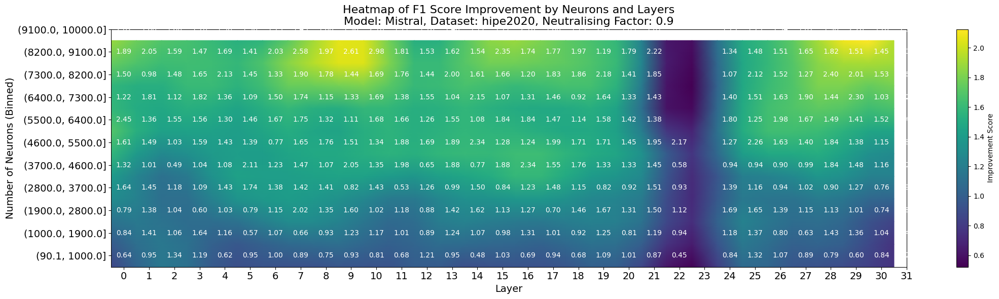

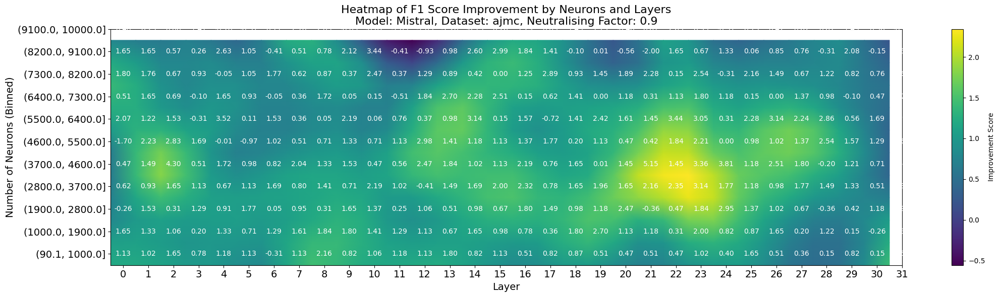

In [616]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import warnings
import numpy as np
from scipy.ndimage import gaussian_filter

MODEL = 'Mistral' # Mistral, LLama 2

warnings.filterwarnings("ignore")

all_data['Layer'] = all_data['Layer'].astype(int)

num_bins = 11

neuron_data = all_data[(all_data['Neurons'] != 0) & (all_data['Layer'] != -1)]

neuron_data['Neurons_Binned'] = pd.cut(neuron_data['Neurons'], bins=num_bins)

datasets = ['hipe2020', 'ajmc']
# datasets = ['ajmc']
dampening_factors = neuron_data['Dampening Factor'].unique()
all_layers = list(range(32))

for dataset in datasets:
    max_f1 = all_data[all_data['Dataset'] == dataset]
    max_f1 = max_f1[max_f1['Layer'] == -1].iloc[0]['f1']
    # print(max_f1)
    
    local_min = float('inf')
    local_max = float('-inf')
    
    for dampening_factor in [0.1, 0.5, 0.9]:
        dataset_data = neuron_data[(neuron_data['Dataset'] == dataset) & 
                                   (neuron_data['Dampening Factor'] == dampening_factor)]
        dataset_data['Improvement_Score'] = (dataset_data['f1'] - max_f1) / max_f1 * 100
        
        current_min = dataset_data['Improvement_Score'].min()
        current_max = dataset_data['Improvement_Score'].max()
        if current_min < local_min:
            local_min = current_min
        if current_max > local_max:
            local_max = current_max
    
    # print(f"Local min for {dataset}:", local_min)
    # print('Max F1', dataset_data['f1'].max(), max_f1)
    # print(f"Local max for {dataset}:", local_max)
# 0.1, 0.5, 
    for dampening_factor in [0.9]:
        dataset_data = neuron_data[(neuron_data['Dataset'] == dataset) & 
                                   (neuron_data['Dampening Factor'] == dampening_factor)]
        dataset_data['Improvement_Score'] = ((dataset_data['f1'] - max_f1) / max_f1) * 100

        pivot_data = dataset_data.pivot_table(values='Improvement_Score', index='Neurons_Binned', columns='Layer', aggfunc='max')

        pivot_data = pivot_data.reindex(columns=all_layers)

        pivot_data_filled = pivot_data.fillna(0)

        smoothed_data = gaussian_filter(pivot_data_filled, sigma=1.0)

        plt.figure(figsize=(22, 6))
        
        X, Y = np.meshgrid(range(len(all_layers)), range(num_bins))
        Z = smoothed_data
        
        if 'hipe' in dataset:
            cmap = 'coolwarm'
        else:
            cmap = 'coolwarm'#'viridis'

        cmap = 'viridis'
        
        plt.pcolormesh(X, Y, Z, shading='gouraud', cmap=cmap)
        
        for y in range(pivot_data.shape[0]):
            for x in range(pivot_data.shape[1]):
                if not np.isnan(pivot_data.iloc[y, x]):
                    plt.text(x + 0.5, y + 0.5, f'{pivot_data.iloc[y, x]:.2f}', ha='center', va='center', color='white', fontsize=10)

        plt.xticks(np.arange(0.5, len(all_layers) + 0.5), all_layers, fontsize=14)
        plt.yticks(np.arange(0.5, num_bins + 0.5), [str(i) for i in pivot_data.index], fontsize=14)

        plt.title(f'Heatmap of F1 Score Improvement by Neurons and Layers\nModel: {MODEL}, Dataset: {dataset}, Neutralising Factor: {dampening_factor}', fontsize=16)
        plt.ylabel('Number of Neurons (Binned)', fontsize=14)
        plt.xlabel('Layer', fontsize=14)
        plt.colorbar(label='Improvement Score')
        plt.tight_layout()
        plt.show()


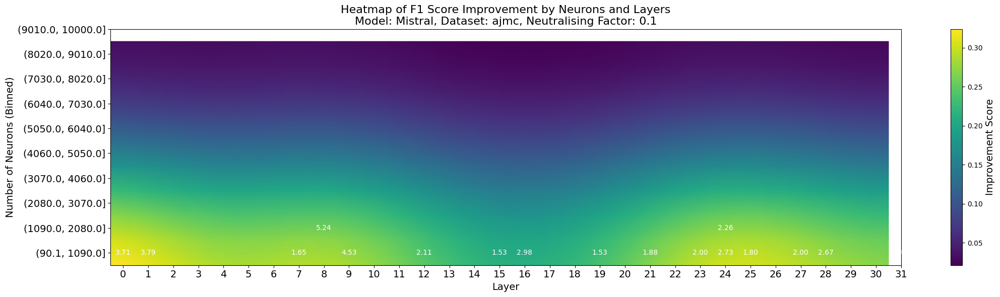

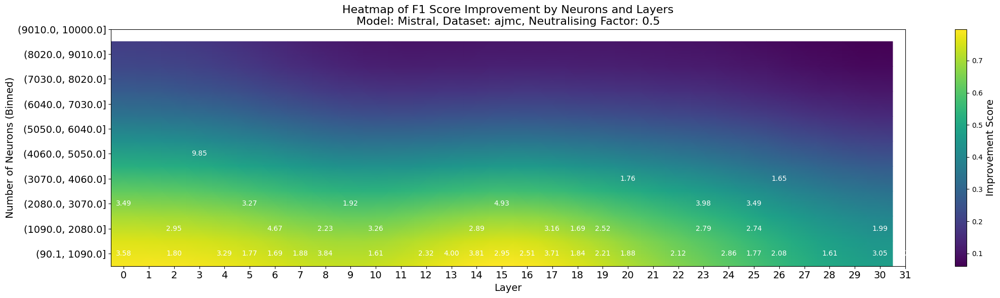

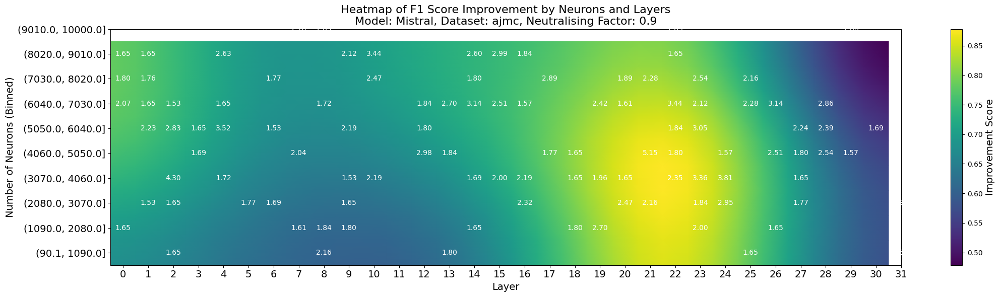

In [642]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import warnings
import numpy as np
from scipy.ndimage import gaussian_filter

warnings.filterwarnings("ignore")

all_data['Layer'] = all_data['Layer'].astype(int)

num_bins = 10

neuron_data = all_data[(all_data['Neurons'] != 0) & (all_data['Layer'] != -1)]

neuron_data['Neurons_Binned'] = pd.cut(neuron_data['Neurons'], bins=num_bins)

datasets = ['ajmc']
dampening_factors = neuron_data['Dampening Factor'].unique()
all_layers = list(range(32))

for dataset in datasets:
    max_f1 = all_data[all_data['Dataset'] == dataset]
    max_f1 = max_f1[max_f1['Layer'] == -1].iloc[0]['f1']
    # print(max_f1)
    
    local_min = float('inf')
    local_max = float('-inf')
    
    for dampening_factor in [0.1, 0.5, 0.9]:
        dataset_data = neuron_data[(neuron_data['Dataset'] == dataset) & 
                                   (neuron_data['Dampening Factor'] == dampening_factor)]
        dataset_data['Improvement_Score'] = (dataset_data['f1'] - max_f1) / max_f1 * 100
        dataset_data.loc[dataset_data['Improvement_Score'] < 0, 'Improvement_Score'] = 0  # Set negative values to 0
        
        current_min = dataset_data['Improvement_Score'].min()
        current_max = dataset_data['Improvement_Score'].max()
        if current_min < local_min:
            local_min = current_min
        if current_max > local_max:
            local_max = current_max
    
    # print(f"Local min for {dataset}:", local_min)
    # print(f"Local max for {dataset}:", local_max)

    for dampening_factor in [0.1, 0.5, 0.9]:
        dataset_data = neuron_data[(neuron_data['Dataset'] == dataset) & 
                                   (neuron_data['Dampening Factor'] == dampening_factor)]
        dataset_data['Improvement_Score'] = (dataset_data['f1'] - max_f1) / max_f1 * 100
        dataset_data.loc[dataset_data['Improvement_Score'] < 1.5, 'Improvement_Score'] = 0  # Set negative values to 0

        pivot_data = dataset_data.pivot_table(values='Improvement_Score', index='Neurons_Binned', columns='Layer', aggfunc='max')

        pivot_data = pivot_data.reindex(columns=all_layers)

        pivot_data_filled = pivot_data.fillna(0)

        smoothed_data = gaussian_filter(pivot_data_filled, sigma=4.0)

        plt.figure(figsize=(22, 6))
        
        X, Y = np.meshgrid(range(len(all_layers)), range(num_bins))
        Z = smoothed_data
        
        plt.pcolormesh(X, Y, Z, shading='gouraud', cmap='viridis')
        
        for y in range(pivot_data.shape[0]):
            for x in range(pivot_data.shape[1]):
                value = pivot_data.iloc[y, x]
                if not np.isnan(value) and value != 0.0:
                    plt.text(x + 0.5, y + 0.5, f'{value:.2f}', ha='center', va='center', color='white')

        plt.xticks(np.arange(0.5, len(all_layers) + 0.5), all_layers, fontsize=14)
        plt.yticks(np.arange(0.5, num_bins + 0.5), [str(i) for i in pivot_data.index], fontsize=14)

        plt.title(f'Heatmap of F1 Score Improvement by Neurons and Layers\nModel: {MODEL}, Dataset: {dataset}, Neutralising Factor: {dampening_factor}', fontsize=16)
        plt.ylabel('Number of Neurons (Binned)', fontsize=14)
        plt.xlabel('Layer', fontsize=14)
        cbar = plt.colorbar(label='Improvement Score')
        cbar.ax.set_ylabel('Improvement Score', fontsize=14)
        plt.tight_layout() 
        plt.show()


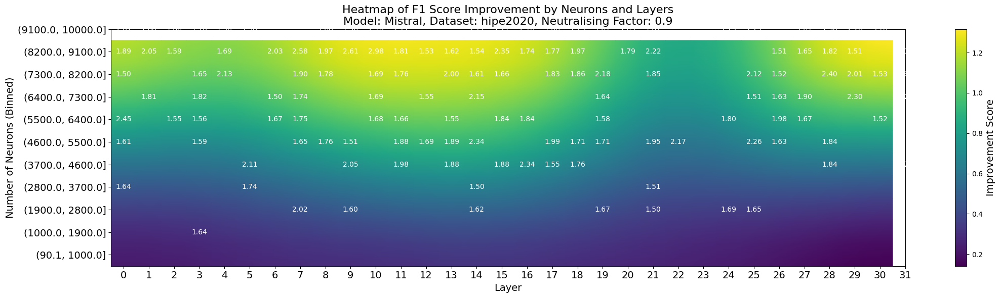

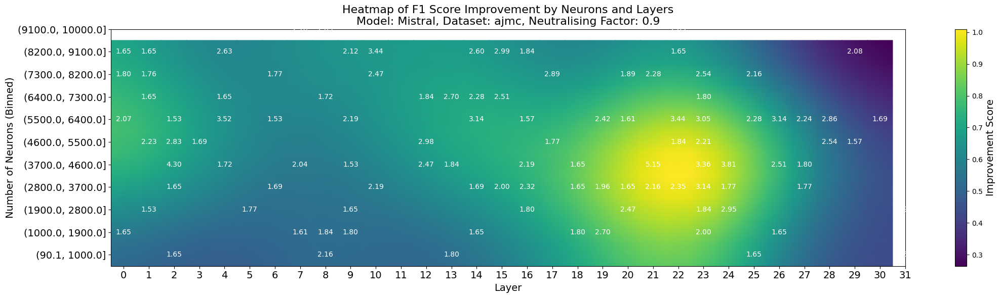

In [617]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import warnings
import numpy as np
from scipy.ndimage import gaussian_filter

MODEL = 'Mistral' # Mistral, LLama 2

warnings.filterwarnings("ignore")

all_data['Layer'] = all_data['Layer'].astype(int)

num_bins = 11

neuron_data = all_data[(all_data['Neurons'] != 0) & (all_data['Layer'] != -1)]

neuron_data['Neurons_Binned'] = pd.cut(neuron_data['Neurons'], bins=num_bins)

datasets = ['hipe2020', 'ajmc']
# datasets = ['ajmc']
dampening_factors = neuron_data['Dampening Factor'].unique()
all_layers = list(range(32))

for dataset in datasets:
    max_f1 = all_data[all_data['Dataset'] == dataset]
    max_f1 = max_f1[max_f1['Layer'] == -1].iloc[0]['f1']
    # print(max_f1)
    
    local_min = float('inf')
    local_max = float('-inf')
    
    for dampening_factor in [0.1, 0.5, 0.9]:
        dataset_data = neuron_data[(neuron_data['Dataset'] == dataset) & 
                                   (neuron_data['Dampening Factor'] == dampening_factor)]
        dataset_data['Improvement_Score'] = (dataset_data['f1'] - max_f1) / max_f1 * 100
        
        current_min = dataset_data['Improvement_Score'].min()
        current_max = dataset_data['Improvement_Score'].max()
        if current_min < local_min:
            local_min = current_min
        if current_max > local_max:
            local_max = current_max
    
    # print(f"Local min for {dataset}:", local_min)
    # print('Max F1', dataset_data['f1'].max(), max_f1)
    # print(f"Local max for {dataset}:", local_max)
    for dampening_factor in [0.9]:
        dataset_data = neuron_data[(neuron_data['Dataset'] == dataset) & 
                                   (neuron_data['Dampening Factor'] == dampening_factor)]
        dataset_data['Improvement_Score'] = ((dataset_data['f1'] - max_f1) / max_f1) * 100
        dataset_data.loc[dataset_data['Improvement_Score'] < 1.5, 'Improvement_Score'] = 0  # Set negative values to 0

        pivot_data = dataset_data.pivot_table(values='Improvement_Score', index='Neurons_Binned', columns='Layer', aggfunc='max')

        pivot_data = pivot_data.reindex(columns=all_layers)

        pivot_data_filled = pivot_data.fillna(0)

        smoothed_data = gaussian_filter(pivot_data_filled, sigma=3)

        plt.figure(figsize=(22, 6))
        
        X, Y = np.meshgrid(range(len(all_layers)), range(num_bins))
        Z = smoothed_data
        
        if 'hipe' in dataset:
            cmap = 'coolwarm'
        else:
            cmap = 'coolwarm'#'viridis'

        cmap = 'viridis'
        
        plt.pcolormesh(X, Y, Z, shading='gouraud', cmap=cmap)
        
        for y in range(pivot_data.shape[0]):
            for x in range(pivot_data.shape[1]):
                value = pivot_data.iloc[y, x]
                if not np.isnan(value) and value != 0.0:
                    plt.text(x + 0.5, y + 0.5, f'{value:.2f}', ha='center', va='center', color='white')

        plt.xticks(np.arange(0.5, len(all_layers) + 0.5), all_layers, fontsize=14)
        plt.yticks(np.arange(0.5, num_bins + 0.5), [str(i) for i in pivot_data.index], fontsize=14)

        plt.title(f'Heatmap of F1 Score Improvement by Neurons and Layers\nModel: {MODEL}, Dataset: {dataset}, Neutralising Factor: {dampening_factor}', fontsize=16)
        plt.ylabel('Number of Neurons (Binned)', fontsize=14)
        plt.xlabel('Layer', fontsize=14)
        cbar = plt.colorbar(label='Improvement Score')
        cbar.ax.set_ylabel('Improvement Score', fontsize=14)
        plt.tight_layout() 
        plt.show()


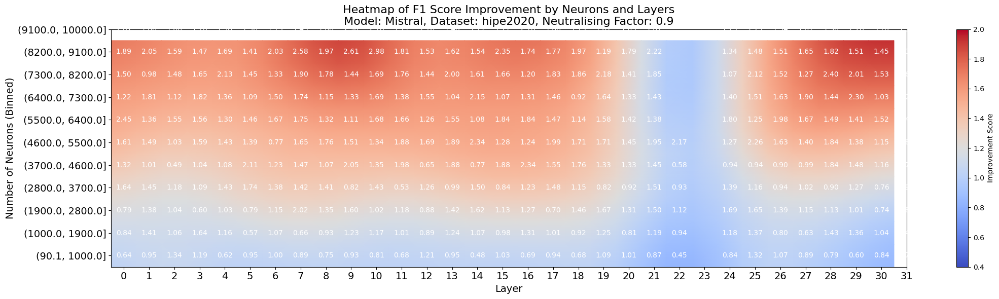

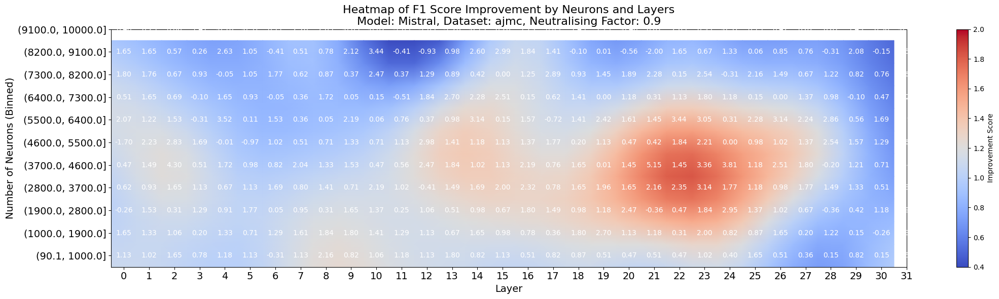

In [618]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import warnings
import numpy as np
from scipy.ndimage import gaussian_filter

MODEL = 'Mistral'  # Mistral, LLama 2

warnings.filterwarnings("ignore")

all_data['Layer'] = all_data['Layer'].astype(int)

num_bins = 11

neuron_data = all_data[(all_data['Neurons'] != 0) & (all_data['Layer'] != -1)]

neuron_data['Neurons_Binned'] = pd.cut(neuron_data['Neurons'], bins=num_bins)

datasets = ['hipe2020', 'ajmc']
# datasets = ['ajmc']
dampening_factors = neuron_data['Dampening Factor'].unique()
all_layers = list(range(32))

for dataset in datasets:
    max_f1 = all_data[all_data['Dataset'] == dataset]
    max_f1 = max_f1[max_f1['Layer'] == -1].iloc[0]['f1']
    
    local_min = float('inf')
    local_max = float('-inf')
    
    for dampening_factor in [0.1, 0.5, 0.9]:
        dataset_data = neuron_data[(neuron_data['Dataset'] == dataset) & 
                                   (neuron_data['Dampening Factor'] == dampening_factor)]
        dataset_data['Improvement_Score'] = (dataset_data['f1'] - max_f1) / max_f1 * 100
        
        current_min = dataset_data['Improvement_Score'].min()
        current_max = dataset_data['Improvement_Score'].max()
        if current_min < local_min:
            local_min = current_min
        if current_max > local_max:
            local_max = current_max
    
    for dampening_factor in [0.9]:
        dataset_data = neuron_data[(neuron_data['Dataset'] == dataset) & 
                                   (neuron_data['Dampening Factor'] == dampening_factor)]
        dataset_data['Improvement_Score'] = ((dataset_data['f1'] - max_f1) / max_f1) * 100

        pivot_data = dataset_data.pivot_table(values='Improvement_Score', index='Neurons_Binned', columns='Layer', aggfunc='max')

        pivot_data = pivot_data.reindex(columns=all_layers)

        pivot_data_filled = pivot_data.fillna(0)

        smoothed_data = gaussian_filter(pivot_data_filled, sigma=1.8)

        plt.figure(figsize=(22, 6))
        
        X, Y = np.meshgrid(range(len(all_layers)), range(num_bins))
        Z = smoothed_data
        
        cmap = 'coolwarm'
        plt.pcolormesh(X, Y, Z, shading='gouraud', cmap=cmap, vmin=0.4, vmax=2)
        
        for y in range(pivot_data.shape[0]):
            for x in range(pivot_data.shape[1]):
                if not np.isnan(pivot_data.iloc[y, x]):
                    plt.text(x + 0.5, y + 0.5, f'{pivot_data.iloc[y, x]:.2f}', ha='center', va='center', color='white', fontsize=10)

        plt.xticks(np.arange(0.5, len(all_layers) + 0.5), all_layers, fontsize=14)
        plt.yticks(np.arange(0.5, num_bins + 0.5), [str(i) for i in pivot_data.index], fontsize=14)

        plt.title(f'Heatmap of F1 Score Improvement by Neurons and Layers\nModel: {MODEL}, Dataset: {dataset}, Neutralising Factor: {dampening_factor}', fontsize=16)
        plt.ylabel('Number of Neurons (Binned)', fontsize=14)
        plt.xlabel('Layer', fontsize=14)
        plt.colorbar(label='Improvement Score')
        plt.tight_layout()  # Adjust the layout to fit everything nicely
        plt.show()


52.887139107611546
Local min for hipe2020: -100.0
Local max for hipe2020: 4.511181398918086


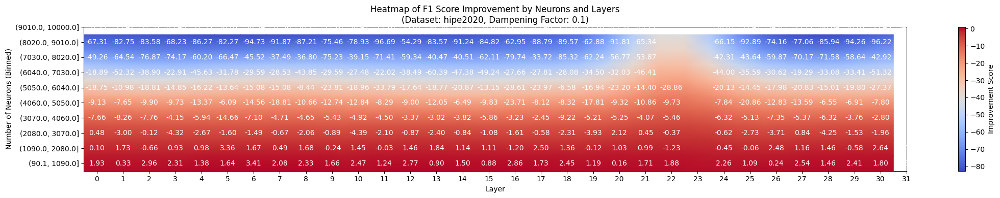

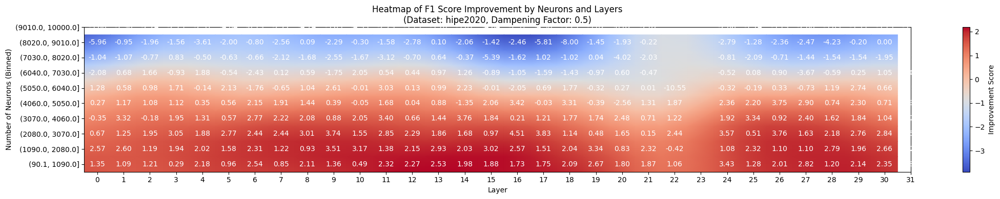

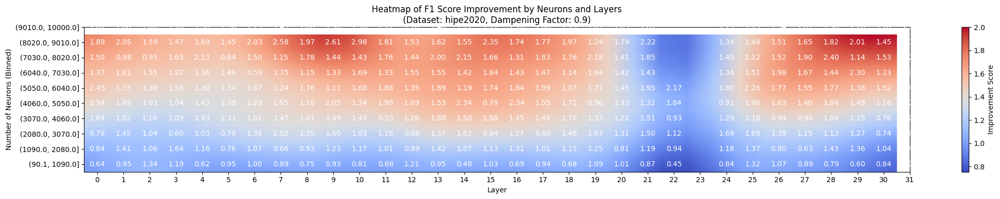

46.296296296296305
Local min for ajmc: -100.0
Local max for ajmc: 9.853354134165347


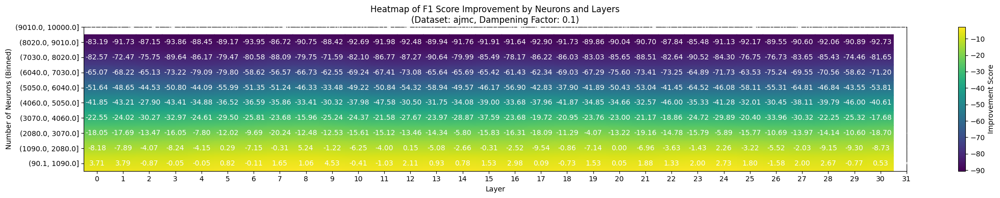

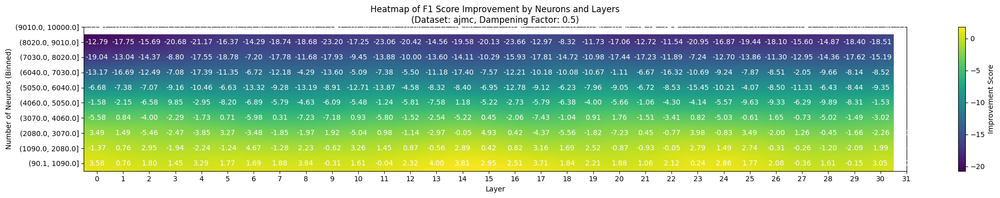

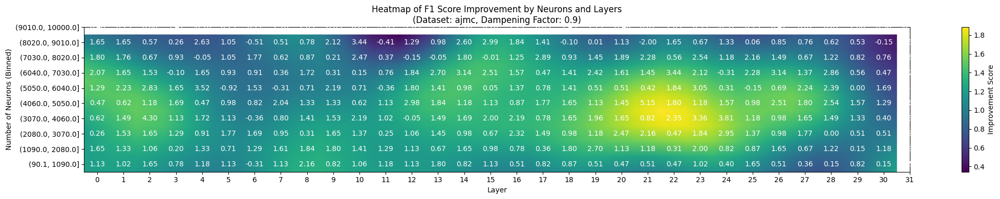

In [640]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import warnings
import numpy as np
from scipy.ndimage import gaussian_filter

MODEL = 'Mistral' # Mistral, LLama 2
warnings.filterwarnings("ignore")

all_data['Layer'] = all_data['Layer'].astype(int)

num_bins = 10

neuron_data = all_data[(all_data['Neurons'] != 0) & (all_data['Layer'] != -1)]

neuron_data['Neurons_Binned'] = pd.cut(neuron_data['Neurons'], bins=num_bins)

datasets = ['hipe2020', 'ajmc']
dampening_factors = neuron_data['Dampening Factor'].unique()
all_layers = list(range(32)) 

for dataset in datasets:
    max_f1 = all_data[all_data['Dataset'] == dataset]
    max_f1 = max_f1[max_f1['Layer'] == -1].iloc[0]['f1']
    print(max_f1)
    
    local_min = float('inf')
    local_max = float('-inf')
    
    for dampening_factor in [0.1, 0.5, 0.9]:
        dataset_data = neuron_data[(neuron_data['Dataset'] == dataset) & 
                                   (neuron_data['Dampening Factor'] == dampening_factor)]
        dataset_data['Improvement_Score'] = (dataset_data['f1'] - max_f1) / max_f1 * 100
        
        current_min = dataset_data['Improvement_Score'].min()
        current_max = dataset_data['Improvement_Score'].max()
        if current_min < local_min:
            local_min = current_min
        if current_max > local_max:
            local_max = current_max
    
    print(f"Local min for {dataset}:", local_min)
    print(f"Local max for {dataset}:", local_max)

    for dampening_factor in [0.1, 0.5, 0.9]:
        dataset_data = neuron_data[(neuron_data['Dataset'] == dataset) & 
                                   (neuron_data['Dampening Factor'] == dampening_factor)]
        dataset_data['Improvement_Score'] = (dataset_data['f1'] - max_f1) / max_f1 * 100

        pivot_data = dataset_data.pivot_table(values='Improvement_Score', index='Neurons_Binned', columns='Layer', aggfunc='max')

        pivot_data = pivot_data.reindex(columns=all_layers)

        pivot_data_filled = pivot_data.fillna(0)

        smoothed_data = gaussian_filter(pivot_data_filled, sigma=1.5)

        plt.figure(figsize=(22, 4))
        
        X, Y = np.meshgrid(range(len(all_layers)), range(num_bins))
        Z = smoothed_data

        if 'hipe' in dataset:
            cmap = 'coolwarm'
        else:
            cmap = 'viridis'
        plt.pcolormesh(X, Y, Z, shading='gouraud', cmap=cmap)
        
        for y in range(pivot_data.shape[0]):
            for x in range(pivot_data.shape[1]):
                if not np.isnan(pivot_data.iloc[y, x]):
                    plt.text(x + 0.5, y + 0.5, f'{pivot_data.iloc[y, x]:.2f}', ha='center', va='center', color='white')

        plt.xticks(np.arange(0.5, len(all_layers) + 0.5), all_layers)
        plt.yticks(np.arange(0.5, num_bins + 0.5), [str(i) for i in pivot_data.index])

        plt.title(f'Heatmap of F1 Score Improvement by Neurons and Layers\n(Dataset: {dataset}, Dampening Factor: {dampening_factor})')
        plt.ylabel('Number of Neurons (Binned)')
        plt.xlabel('Layer')
        plt.colorbar(label='Improvement Score')
        plt.tight_layout() 
        plt.show()


Local min for hipe2020: -100.0
Local max for hipe2020: 3.4069549424469763
Local min for ajmc: -100.0
Local max for ajmc: 5.239097744360895


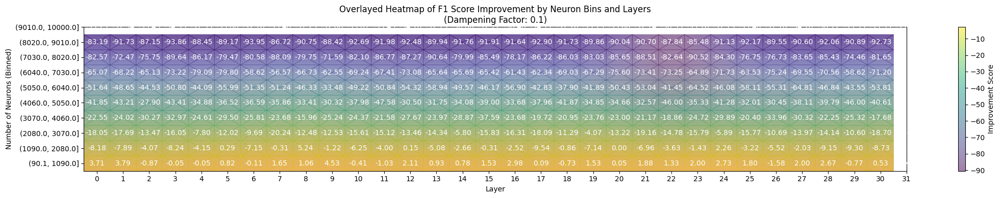

Local min for hipe2020: -98.48552754620682
Local max for hipe2020: 4.511181398918086
Local min for ajmc: -94.60518731988472
Local max for ajmc: 9.853354134165347


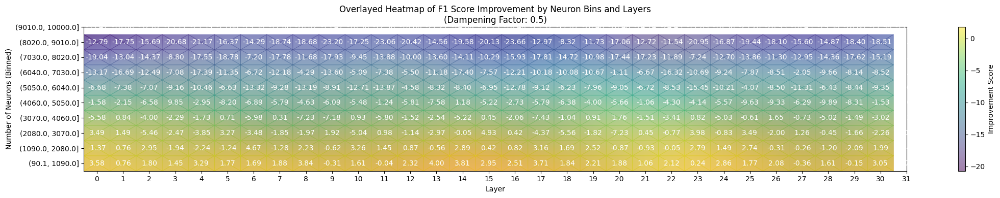

Local min for hipe2020: -2.4656762932360636
Local max for hipe2020: 3.18161163220938
Local min for ajmc: -6.719754977029117
Local max for ajmc: 5.1534883720930065


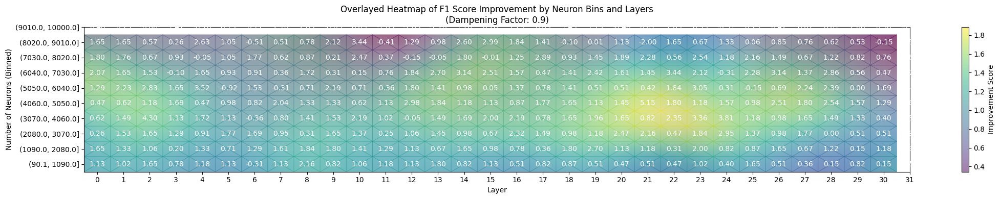

In [620]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import warnings
import numpy as np
from scipy.ndimage import gaussian_filter

warnings.filterwarnings("ignore")

all_data['Layer'] = all_data['Layer'].astype(int)

num_bins = 10

neuron_data = all_data[(all_data['Neurons'] != 0) & (all_data['Layer'] != -1)]

neuron_data['Neurons_Binned'] = pd.cut(neuron_data['Neurons'], bins=num_bins)

datasets = ['hipe2020', 'ajmc']
dampening_factors = [0.1, 0.5, 0.9]
all_layers = list(range(32)) 

for dampening_factor in dampening_factors:
    fig, ax = plt.subplots(figsize=(22, 4))

    for dataset, color in zip(datasets, ['coolwarm', 'viridis']):
        max_f1 = all_data[all_data['Dataset'] == dataset]
        max_f1 = max_f1[max_f1['Layer'] == -1].iloc[0]['f1']
        
        local_min = float('inf')
        local_max = float('-inf')
        
        dataset_data = neuron_data[(neuron_data['Dataset'] == dataset) & 
                                   (neuron_data['Dampening Factor'] == dampening_factor)]
        dataset_data['Improvement_Score'] = (dataset_data['f1'] - max_f1) / max_f1 * 100
        
        current_min = dataset_data['Improvement_Score'].min()
        current_max = dataset_data['Improvement_Score'].max()
        if current_min < local_min:
            local_min = current_min
        if current_max > local_max:
            local_max = current_max
        
        print(f"Local min for {dataset}:", local_min)
        print(f"Local max for {dataset}:", local_max)

        pivot_data = dataset_data.pivot_table(values='Improvement_Score', index='Neurons_Binned', columns='Layer', aggfunc='max')

        pivot_data = pivot_data.reindex(columns=all_layers)

        pivot_data_filled = pivot_data.fillna(0)

        smoothed_data = gaussian_filter(pivot_data_filled, sigma=1.5)

        X, Y = np.meshgrid(range(len(all_layers)), range(num_bins))
        Z = smoothed_data
        
        c = ax.pcolormesh(X, Y, Z, shading='gouraud', cmap=color, alpha=0.5, edgecolors='k')

    for y in range(pivot_data.shape[0]):
        for x in range(pivot_data.shape[1]):
            if not np.isnan(pivot_data.iloc[y, x]):
                plt.text(x + 0.5, y + 0.5, f'{pivot_data.iloc[y, x]:.2f}', ha='center', va='center', color='white')

    plt.xticks(np.arange(0.5, len(all_layers) + 0.5), all_layers)
    plt.yticks(np.arange(0.5, num_bins + 0.5), [str(i) for i in pivot_data.index])

    plt.title(f'Overlayed Heatmap of F1 Score Improvement by Neuron Bins and Layers\n(Dampening Factor: {dampening_factor})')
    plt.ylabel('Number of Neurons (Binned)')
    plt.xlabel('Layer')
    plt.colorbar(c, label='Improvement Score')
    plt.tight_layout()
    plt.show()


In [621]:
max_f1 = neuron_data[neuron_data['Dataset'] == dataset]['f1'].max()

max_f1

50.858034321372855

In [622]:
max_f1 = all_data[all_data['Dampening Factor'] == 1.0]['f1'].iloc[0]
max_f1

46.296296296296305

In [623]:
neuron_data.Layer.unique()

array([18, 21, 17, 26, 25,  4, 10, 28,  2, 12, 15, 16, 22, 14, 27,  3, 30,
       31,  8,  9, 24, 20,  5, 11,  0,  7, 13, 19, 23,  1, 29,  6])

In [624]:
all_data.loc[all_data['Dampening Factor'] == 1.0]

,precision,recall,f1,accuracy,Folder,Layer,Neurons,Dataset,Dampening Factor
12695,0.476190,0.45045,46.296296,0.935338,test_-1_-1_-1.0_ajmc,-1,0,ajmc,1.0
23858,0.491164,0.57285,52.887139,0.954922,test_-1_-1_-1.0_hipe2020,-1,0,hipe2020,1.0


In [625]:
all_data.head()

,precision,recall,f1,accuracy,Folder,Layer,Neurons,Dataset,Dampening Factor
0,0.242588,0.270270,25.568182,0.890033,test_18_5000_0.1_ajmc,18,5000,ajmc,0.1
1,0.242588,0.270270,25.568182,0.890033,test_18_5000_0.1_ajmc,18,5000,ajmc,0.1
2,0.494232,0.578536,53.307138,0.954892,test_21_9600_0.9_hipe2020,21,9600,hipe2020,0.9
3,0.494232,0.578536,53.307138,0.954892,test_21_9600_0.9_hipe2020,21,9600,hipe2020,0.9
4,0.465409,0.444444,45.468510,0.934720,test_17_7400_0.9_ajmc,17,7400,ajmc,0.9


In [626]:
all_data[all_data.Dataset == 'ajmc']

,precision,recall,f1,accuracy,Folder,Layer,Neurons,Dataset,Dampening Factor
0,0.242588,0.270270,25.568182,0.890033,test_18_5000_0.1_ajmc,18,5000,ajmc,0.1
1,0.242588,0.270270,25.568182,0.890033,test_18_5000_0.1_ajmc,18,5000,ajmc,0.1
4,0.465409,0.444444,45.468510,0.934720,test_17_7400_0.9_ajmc,17,7400,ajmc,0.9
5,0.465409,0.444444,45.468510,0.934720,test_17_7400_0.9_ajmc,17,7400,ajmc,0.9
6,0.469841,0.444444,45.679012,0.934720,test_26_2700_0.9_ajmc,26,2700,ajmc,0.9
...,...,...,...,...,...,...,...,...,...
37411,0.491909,0.456456,47.352025,0.936367,test_21_7700_0.9_ajmc,21,7700,ajmc,0.9
37414,0.000000,0.000000,0.000000,0.014003,test_26_7700_0.1_ajmc,26,7700,ajmc,0.1
37415,0.000000,0.000000,0.000000,0.014003,test_26_7700_0.1_ajmc,26,7700,ajmc,0.1
37418,0.059752,0.159159,8.688525,0.506590,test_19_8800_0.5_ajmc,19,8800,ajmc,0.5


In [627]:
all_data['Dampening Factor'].unique()

array([0.1, 0.9, 0.5, 1. ])

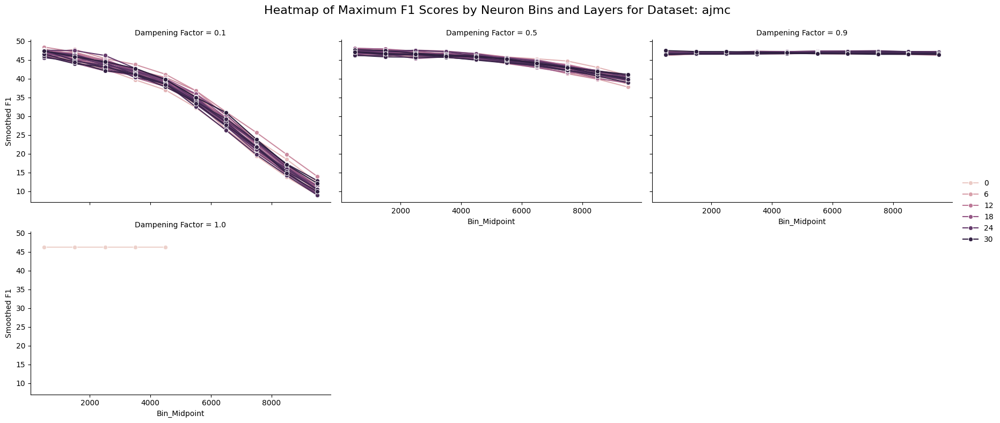

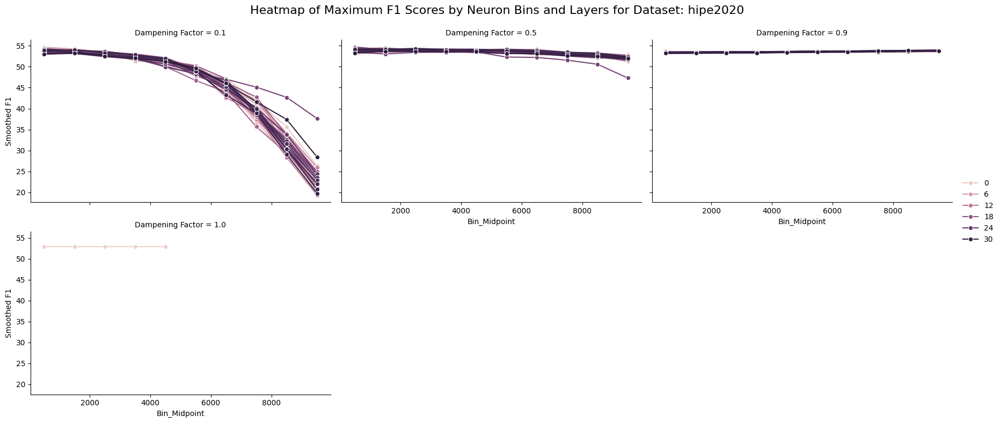

In [628]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

num_bins = 10  # A smaller, more reasonable number
all_data['Neurons_Binned'] = pd.cut(all_data['Neurons'], bins=num_bins)
all_data['Bin_Midpoint'] = all_data['Neurons_Binned'].apply(lambda x: x.mid)

for dataset in all_data['Dataset'].unique():
    dataset_data = all_data[all_data['Dataset'] == dataset]
    line_data = dataset_data.groupby(['Layer', 'Bin_Midpoint', 'Dampening Factor'])['f1'].max().reset_index()

    df_star = line_data[line_data['Dampening Factor'] == -1]
    line_data = line_data[line_data['Dampening Factor'] != -1]

    df_star_lines = pd.DataFrame()
    for layer in df_star['Layer'].unique():
        layer_data = df_star[df_star['Layer'] == layer]
        f1_value = layer_data['f1'].values[0]
        f1_std_data = dataset_data[(dataset_data['Layer'] == layer) & (dataset_data['Dampening Factor'] == -1)]
        
        if not f1_std_data.empty:
            f1_std = f1_std_data['f1_std'].values[0]
            for midpoint in line_data['Bin_Midpoint'].unique():
                df_star_lines = pd.concat([df_star_lines, pd.DataFrame({
                    'Layer': [layer], 
                    'Bin_Midpoint': [midpoint], 
                    'f1': [f1_value], 
                    'f1_std': [f1_std], 
                    'Dampening Factor': [-1]
                })])

    line_data['Smoothed F1'] = line_data.groupby(['Layer', 'Dampening Factor'])['f1'].transform(lambda x: x.rolling(window=5, min_periods=1).mean())
    line_data = line_data[line_data.Layer != '-1']

    g = sns.FacetGrid(line_data, col='Dampening Factor', col_wrap=3, height=4, aspect=1.5)
    g.map_dataframe(sns.lineplot, x='Bin_Midpoint', y='Smoothed F1', hue='Layer', marker='o')
    g.add_legend()

    # for ax in g.axes.flat:
    #     damp_factor = float(ax.get_title().split('=')[-1].strip())
    #     if damp_factor != -1:
    #         for layer in df_star_lines['Layer'].unique():
    #             layer_data = df_star_lines[df_star_lines['Layer'] == layer]
    #             if not layer_data.empty:
    #                 ax.plot(layer_data['Bin_Midpoint'], layer_data['f1'], 'r--', linewidth=2)
    #                 f1_std = layer_data['f1_std'].values[0]
    #                 lower_bound = layer_data['f1'] - f1_std
    #                 upper_bound = layer_data['f1'] + f1_std
    #                 ax.fill_between(layer_data['Bin_Midpoint'], lower_bound, upper_bound, color='red', alpha=0.2)

    #     ax.set_ylim(50, 53)  # Set y-axis limits

    plt.subplots_adjust(top=0.9)
    plt.suptitle(f'Heatmap of Maximum F1 Scores by Neuron Bins and Layers for Dataset: {dataset}', size=16)
    plt.show()


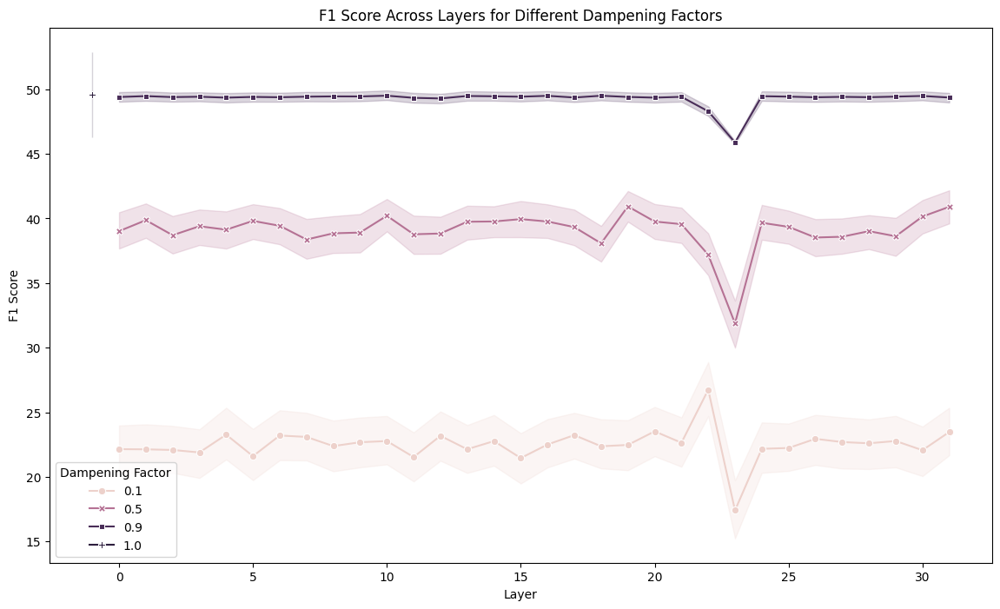

In [629]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(14, 8))
sns.lineplot(data=all_data, x='Layer', y='f1', hue='Dampening Factor', style='Dampening Factor', markers=True, dashes=False)
plt.title('F1 Score Across Layers for Different Dampening Factors')
plt.xlabel('Layer')
plt.ylabel('F1 Score')
plt.legend(title='Dampening Factor')
plt.show()


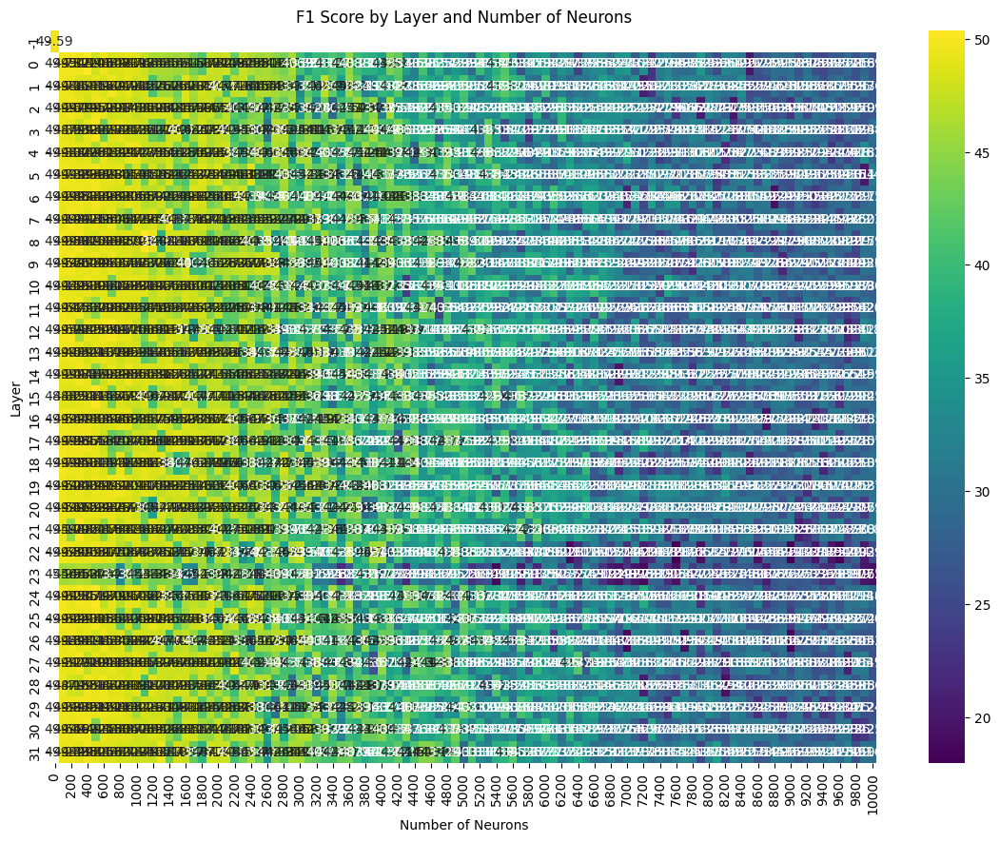

In [630]:
heatmap_data = all_data.pivot_table(index='Layer', columns='Neurons', values='f1', aggfunc='mean')

plt.figure(figsize=(14, 10))
sns.heatmap(heatmap_data, cmap='viridis', annot=True, fmt='.2f')
plt.title('F1 Score by Layer and Number of Neurons')
plt.xlabel('Number of Neurons')
plt.ylabel('Layer')
plt.show()


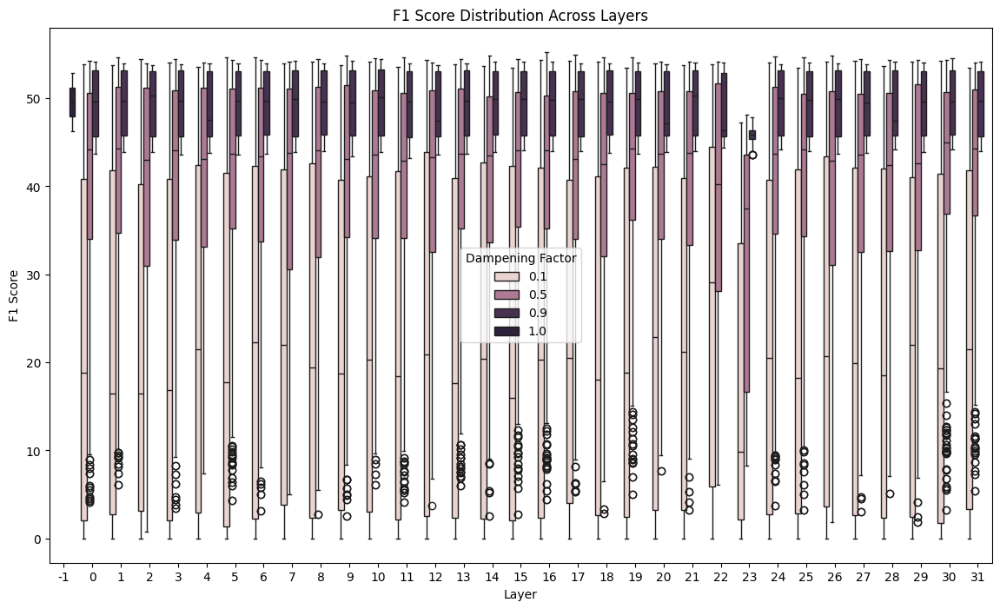

In [631]:
plt.figure(figsize=(14, 8))
sns.boxplot(data=all_data, x='Layer', y='f1', hue='Dampening Factor')
plt.title('F1 Score Distribution Across Layers')
plt.xlabel('Layer')
plt.ylabel('F1 Score')
plt.legend(title='Dampening Factor')
plt.show()


Calculate Similarity Metrics
One way to quantify similarity is to calculate correlation coefficients for performance metrics across datasets for each layer and dampening factor.

Calculate Similarity Metrics
One way to quantify similarity is to calculate correlation coefficients for performance metrics across datasets for each layer and dampening factor.

In [632]:
datasets = all_data['Dataset'].unique()

mean_f1_scores = all_data.groupby(['Layer', 'Dampening Factor', 'Dataset'])['f1'].mean().reset_index()

pivoted_f1 = mean_f1_scores.pivot_table(index=['Layer', 'Dampening Factor'], columns='Dataset', values='f1')

correlation_matrix = pivoted_f1.corr()

print(correlation_matrix)


Dataset       ajmc  hipe2020
Dataset                     
ajmc      1.000000  0.959947
hipe2020  0.959947  1.000000


In [633]:
datasets = all_data['Dataset'].unique()

mean_f1_scores = all_data.groupby(['Layer', 'Dampening Factor', 'Dataset'])['f1'].mean().reset_index()

pivoted_f1 = mean_f1_scores.pivot_table(index=['Layer', 'Dampening Factor'], columns='Dataset', values='f1')

correlation_matrix = pivoted_f1.corr()

print(correlation_matrix)


Dataset       ajmc  hipe2020
Dataset                     
ajmc      1.000000  0.959947
hipe2020  0.959947  1.000000


In [634]:
datasets = all_data['Dataset'].unique()

mean_f1_scores = all_data.groupby(['Layer', 'Dampening Factor', 'Dataset'])['f1'].mean().reset_index()

pivoted_f1 = mean_f1_scores.pivot_table(index=['Layer', 'Dampening Factor'], columns='Dataset', values='f1')

correlation_matrix = pivoted_f1.corr()

print(correlation_matrix)


Dataset       ajmc  hipe2020
Dataset                     
ajmc      1.000000  0.959947
hipe2020  0.959947  1.000000


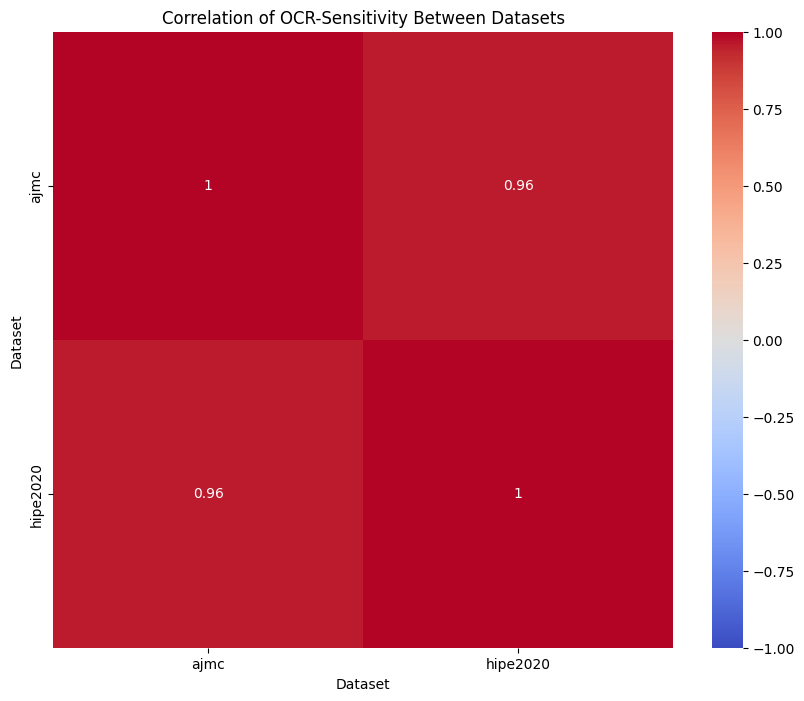

In [635]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation of OCR-Sensitivity Between Datasets')
plt.show()


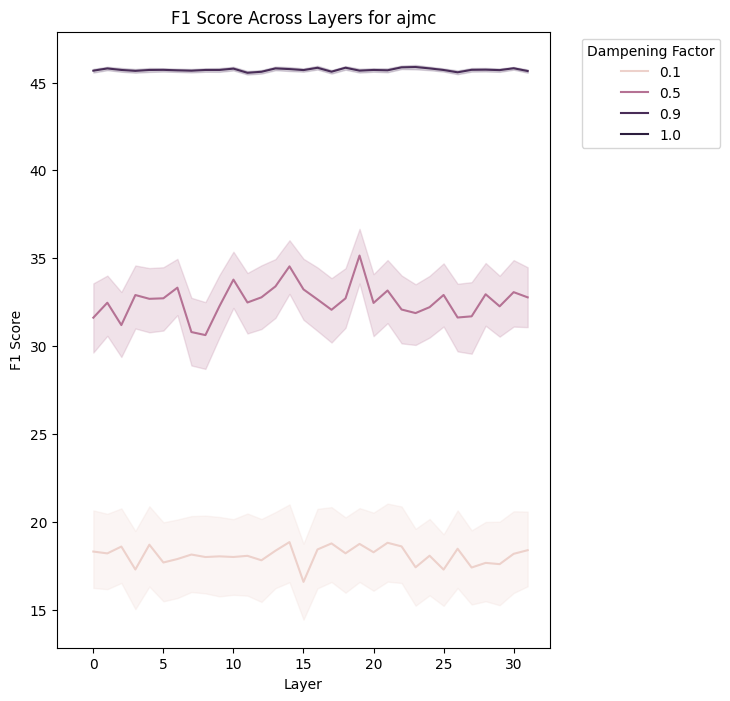

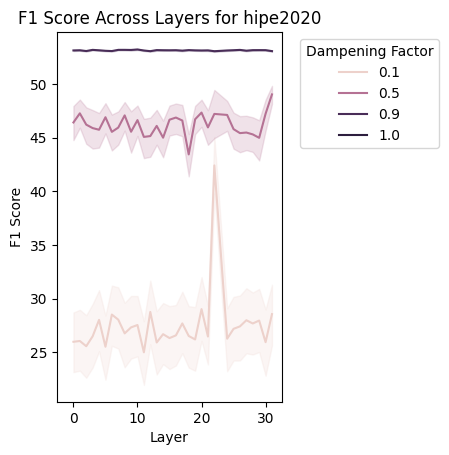

In [636]:
plt.figure(figsize=(14, 8))

for dataset in all_data['Dataset'].unique():
    dataset_data = all_data[all_data['Dataset'] == dataset]
    plt.subplot(1, 2, 1)  # Adjust the subplot parameters accordingly
    sns.lineplot(data=dataset_data, x='Layer', y='f1', hue='Dampening Factor', markers=True, dashes=False)
    plt.title(f'F1 Score Across Layers for {dataset}')
    plt.xlabel('Layer')
    plt.ylabel('F1 Score')
    plt.legend(title='Dampening Factor', bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.axhline(y=dataset_data[dataset_data['Dampening Factor'] == -1]['f1'].mean(), color='red', linestyle='--', label='No Dampening (Baseline)')
    plt.show()


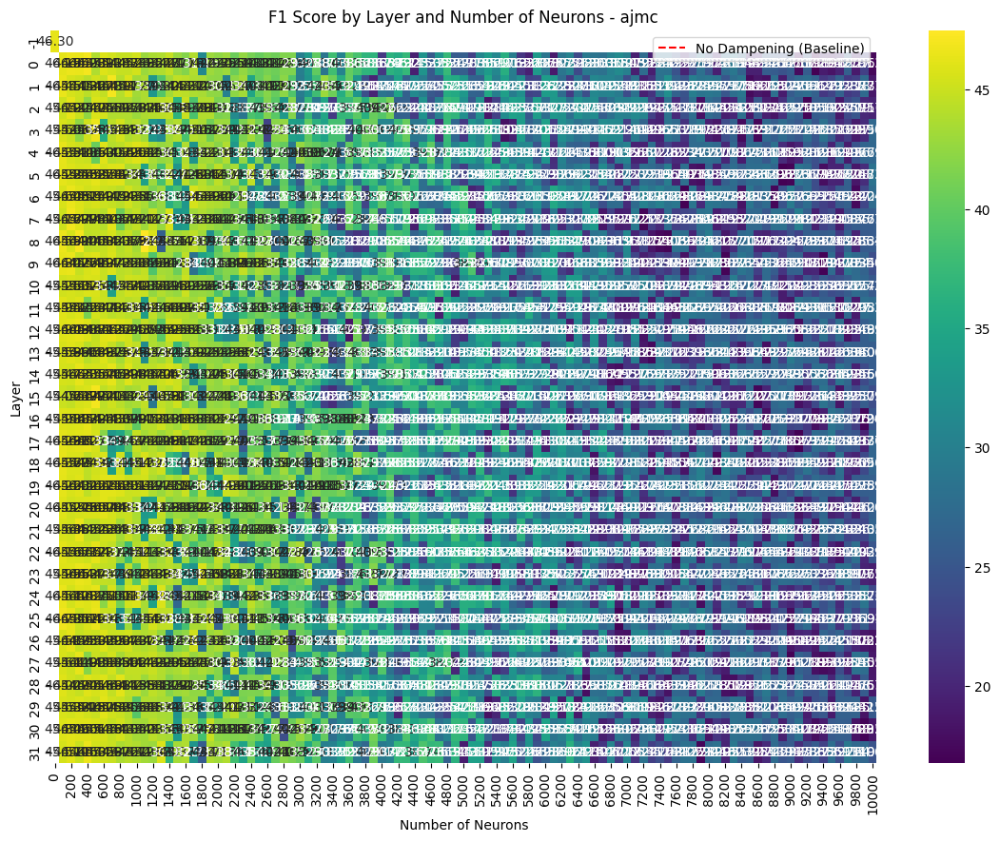

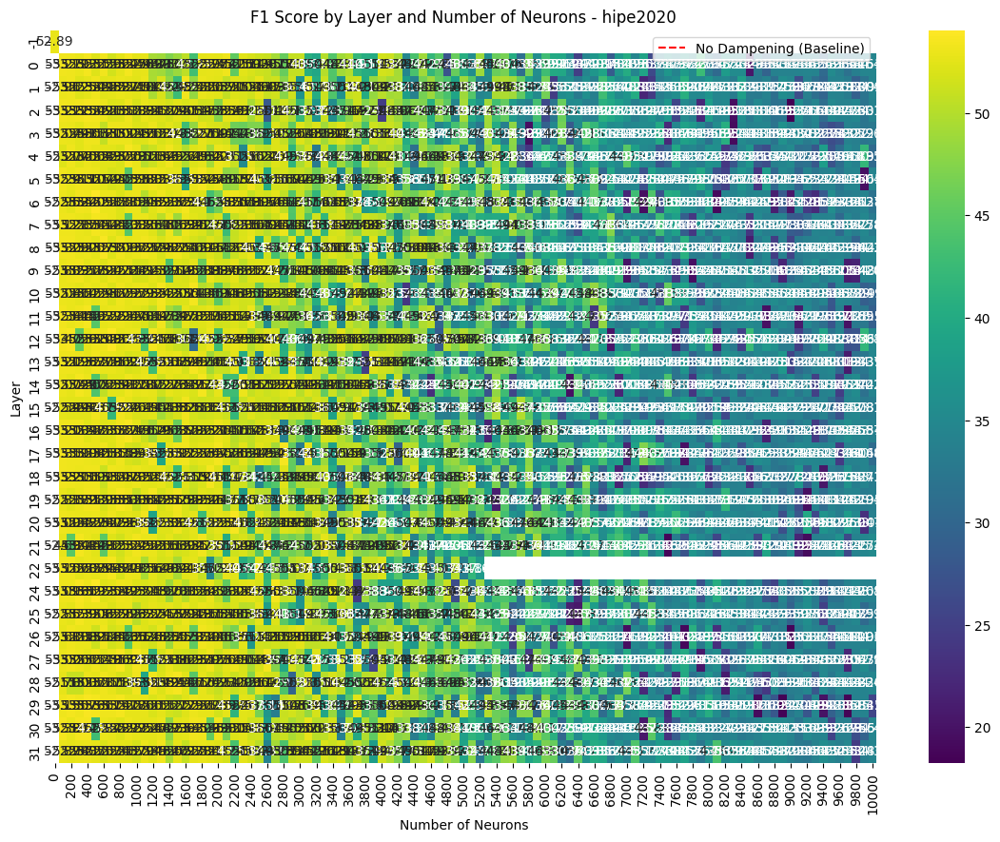

In [637]:
datasets = all_data['Dataset'].unique()

for dataset in datasets:
    plt.figure(figsize=(14, 10))
    dataset_data = all_data[all_data['Dataset'] == dataset]
    heatmap_data = dataset_data.pivot_table(index='Layer', columns='Neurons', values='f1', aggfunc='mean')
    sns.heatmap(heatmap_data, cmap='viridis', annot=True, fmt='.2f')
    plt.title(f'F1 Score by Layer and Number of Neurons - {dataset}')
    plt.xlabel('Number of Neurons')
    plt.ylabel('Layer')
    plt.axhline(y=mean_f1_scores[mean_f1_scores['Dampening Factor'] == -1]['f1'].mean(), color='red', linestyle='--', label='No Dampening (Baseline)')
    plt.legend()
    plt.show()


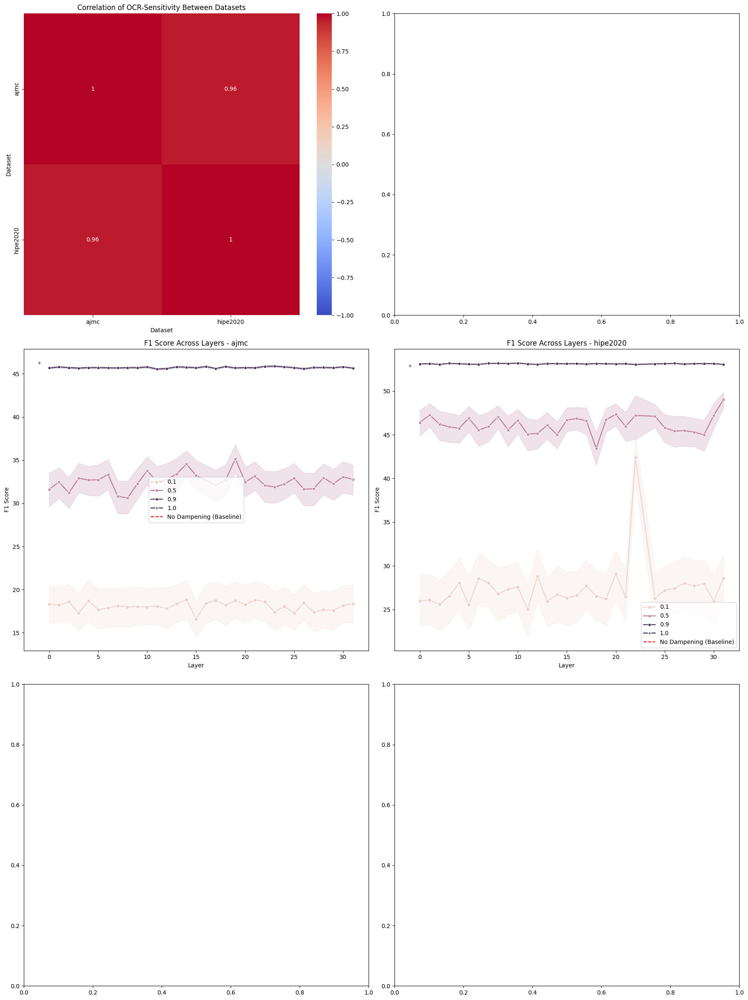

In [638]:
fig, axs = plt.subplots(3, 2, figsize=(18, 24))

sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1, ax=axs[0, 0])
axs[0, 0].set_title('Correlation of OCR-Sensitivity Between Datasets')

for i, dataset in enumerate(datasets):
    sns.lineplot(data=all_data[all_data['Dataset'] == dataset], x='Layer', y='f1', hue='Dampening Factor', style='Dampening Factor', markers=True, dashes=False, ax=axs[i // 2 + 1, i % 2])
    axs[i // 2 + 1, i % 2].set_title(f'F1 Score Across Layers - {dataset}')
    axs[i // 2 + 1, i % 2].set_xlabel('Layer')
    axs[i // 2 + 1, i % 2].set_ylabel('F1 Score')
    axs[i // 2 + 1, i % 2].axhline(y=all_data[(all_data['Dataset'] == dataset) & (all_data['Dampening Factor'] == -1)]['f1'].mean(), color='red', linestyle='--', label='No Dampening (Baseline)')
    axs[i // 2 + 1, i % 2].legend()

plt.tight_layout()
plt.show()
